##  Data Wrangling<a id='1_Data_Wrangling'></a>

## 1.1 Contents<a id='1.1_Contents'></a>

* [1 Data wrangling](#1_Data_Wrangling)
  * [1.1 Contents](#1.1_Contents)
  * [1.2 Introduction](#1.2_Introduction)
  * [1.3 Objectives](#1.3_Objectives)
  * [1.4 Imports](#1.4_Imports)
  * [1.5 Load New York Housing Data](#1.5_Newyork_Housing_Data)
  * [1.6 Explore and Clean The Data](#1.6_Explore_and_Clean_The_Data)
    * [1.6.1 Dropping Columns](#1.6.1_Dropping_Columns)
    * [1.6.2 Drop Rows With No Price Data](#1.6.2_Drop_Rows_With_No_Price_Data)
    * [1.6.3 Anomalies](#1.6.3_Anomalies)
    * [1.6.4 Number Of Missing Values By Column](#1.6.4_Number_Of_Missing_Values_By_Column)
    * [1.6.5 Relabeling of Columns](#1.6.5_Relabel_Columns)
      * [1.6.5.1 Fixing Datatypes of Columns](#1.6.5.1_Fixing_Datatypes_of_columns)
      * [1.6.5.2 Reverse Geolocator](#1.6.5.2_Reverse_Geolocator)
    * [1.6.6 Distribution](#1.6.6_Distribution)
      * [1.6.6.1 Number of distinct neighborhoods](#1.6.6.1_Number_of_distinct_neighborhoods)
      * [1.6.6.2 Distribution Of Housing Price By Borough](#1.6.6.2_Distribution_Of_Housing_Price_By_Borough)
  * [1.7 Neighborhood Statistics](#1.7_Neighborhood_Statistics)
  * [1.8 Save data](#1.8_Save_data)
  * [1.9 Summary](#1.9_Summary)

## 1.2 Introduction<a id='1.2_Introduction and Problem'></a>

Capital Fortune is a midwest real estate company who is looking to invest in the ever-growing NYC market and have bought a significant amount of land in NY which they have start to build many houses that will be finished 2024. These houses will be from single-family homes to multi-family homes. They are seeking help from us to estimate the best pricing for their houses as well as what type of housing equates to the highest net-profit.

## 1.3 Objectives<a id='1.3_Objectives'></a>

Our objective will be to give the best house estimates for Capital Fortune houses which are comparable to other houses in the NYC area, as well as determine which house type yield the highest profit. I will be analyzing similar build houses as well as how those houses price are affected via location and build. In order to achieve our goal we will be using Zillow's Housing dataset which has records upto 01/20/2021

## 1.4 Imports<a id='1.4_Imports'></a>

In [1]:
#Lets get our imports
import pandas as pd
import seaborn as sns
import statistics as stat
import numpy as np
import matplotlib.pyplot as plt
import re
import requests
import matplotlib.ticker as tick
import random

from geopy.geocoders import Nominatim
from geopy.extra.rate_limiter import RateLimiter
from collections import Counter

## 1.5 Load New York Housing Data<a id='1.5_Newyork_Housing_Data'></a>

In [2]:
#The nyc data by zillow is a large dataset with over 75k Observation and 1507 variables
#While I wanted to load it in chunks I notice this would hamper the initial data cleaning process
#As there are lot of missing values and irrevelant columns so I load all of it at once so I can immediately 
#drop unnecessary and missing data

uncleaned_df = pd.read_csv('../data/newyork_housing.csv')

C:\ProgramData\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3146: DtypeWarning: Columns (2,5,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,

## 1.6 Explore and Clean The Data<a id='1.6_Explore_and_Clean_The_Data'></a>

In [3]:
#Lets see what we're working with.
uncleaned_df.info()
#Looks like there are 75630 observations and 1507 columns, thats a lot of features we going to have to shrink that.

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 75630 entries, 0 to 75629
Columns: 1507 entries, address/city to zpid
dtypes: bool(13), float64(440), int64(2), object(1052)
memory usage: 863.0+ MB


In [4]:
#Let's take a peek at what our dataframe looks like
uncleaned_df.head()
#Right off the bat we see a lot of missing data and some columns which are similar like address 

,address/city,address/community,address/neighborhood,address/state,address/streetAddress,address/subdivision,address/zipcode,bathrooms,bedrooms,currency,...,schools/2/link,schools/2/name,schools/2/rating,schools/2/size,schools/2/studentsPerTeacher,schools/2/totalCount,schools/2/type,url,yearBuilt,zpid
0,New York,NaN,NaN,NY,60 Terrace View Ave,NaN,10463.0,2.0,5.0,USD,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,https://www.zillow.com/homedetails/60-Terrace-...,1920.0,3.155405e+07
1,Bronx,NaN,NaN,NY,625 W 246th St,NaN,10471.0,8.0,8.0,USD,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,https://www.zillow.com/homedetails/625-W-246th...,1940.0,2.985412e+07
2,Bronx,NaN,NaN,NY,716 W 231st St,NaN,10463.0,3.0,4.0,USD,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,https://www.zillow.com/homedetails/716-W-231st...,1920.0,2.985186e+07
3,Bronx,NaN,NaN,NY,750 W 232nd St,NaN,10463.0,6.0,5.0,USD,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,https://www.zillow.com/homedetails/750-W-232nd...,1950.0,2.985186e+07
4,Bronx,NaN,NaN,NY,632 W 230th St,NaN,10463.0,6.0,5.0,USD,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,https://www.zillow.com/homedetails/632-W-230th...,2020.0,2.077107e+09


### 1.6.1 Dropping Columns<a id='1.6.1_Dropping_Columns'></a>

In [5]:
#It seems there are columns such as photos which are irrelevant for data analysis lets drop all columns with photo tagline
uncleaned_df = uncleaned_df.drop(uncleaned_df.filter(like='photos',axis=1).columns,axis=1)

In [6]:
sum(uncleaned_df['priceHistory'] == np.nan)
#We can see the priceHistory column is useless it all missing data lets drop this column
#I am going to have to drop a lot of columns which serve no purpose similar to priceHistory 


0

In [7]:
#Most of the columns are a history of price change but we won't be needing this for our problem so we will be ridding ourselfs
#of all columns with priceHistory
uncleaned_df = uncleaned_df.drop(uncleaned_df.filter(like='priceHistory',axis=1).columns,axis=1)
#Lets look at our new df
uncleaned_df.head()

,address/city,address/community,address/neighborhood,address/state,address/streetAddress,address/subdivision,address/zipcode,bathrooms,bedrooms,currency,...,schools/2/link,schools/2/name,schools/2/rating,schools/2/size,schools/2/studentsPerTeacher,schools/2/totalCount,schools/2/type,url,yearBuilt,zpid
0,New York,NaN,NaN,NY,60 Terrace View Ave,NaN,10463.0,2.0,5.0,USD,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,https://www.zillow.com/homedetails/60-Terrace-...,1920.0,3.155405e+07
1,Bronx,NaN,NaN,NY,625 W 246th St,NaN,10471.0,8.0,8.0,USD,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,https://www.zillow.com/homedetails/625-W-246th...,1940.0,2.985412e+07
2,Bronx,NaN,NaN,NY,716 W 231st St,NaN,10463.0,3.0,4.0,USD,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,https://www.zillow.com/homedetails/716-W-231st...,1920.0,2.985186e+07
3,Bronx,NaN,NaN,NY,750 W 232nd St,NaN,10463.0,6.0,5.0,USD,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,https://www.zillow.com/homedetails/750-W-232nd...,1950.0,2.985186e+07
4,Bronx,NaN,NaN,NY,632 W 230th St,NaN,10463.0,6.0,5.0,USD,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,https://www.zillow.com/homedetails/632-W-230th...,2020.0,2.077107e+09


In [8]:
#There are over 1500 variables and reso seems have a lot, so lets drop all reso columns if they have more than 50% missinig data
reso_drop_list = [] 
for i in uncleaned_df.columns:
    if 'reso' in i:
        reso_drop_list.append(i)
        
len(reso_drop_list)
    

606

In [9]:
#After some tedious work on seeing which reso columns has reliable data as most were missing and irrelevant these 
#were the columns left that seem relevant but there will be further cleaning.
reso_list = ['resoFactsStats/atAGlanceFacts/0/factValue', 'resoFactsStats/atAGlanceFacts/1/factValue', 
            'resoFactsStats/atAGlanceFacts/3/factLabel','resoFactsStats/atAGlanceFacts/4/factLabel', 'resoFactsStats/atAGlanceFacts/4/factValue',
            'resoFactsStats/atAGlanceFacts/7/factLabel','resoFactsStats/atAGlanceFacts/7/factValue', 'resoFactsStats/basement', 'resoFactsStats/bathrooms', 'resoFactsStats/bathroomsFull', 
            'resoFactsStats/bathroomsHalf', 'resoFactsStats/bedrooms', 'resoFactsStats/cityRegion',
            'resoFactsStats/hasCooling', 'resoFactsStats/hasFireplace', 'resoFactsStats/hasHeating', 'resoFactsStats/hasSpa',
            'resoFactsStats/homeType', 'resoFactsStats/livingArea', 'resoFactsStats/lotSize', 'resoFactsStats/parkingFeatures/0',
            'resoFactsStats/parkingFeatures/1', 'resoFactsStats/stories', 'resoFactsStats/taxAnnualAmount', 'resoFactsStats/taxAssessedValue',
             'resoFactsStats/yearBuilt']


In [10]:
reso_drop = [x for x in reso_drop_list if x not in reso_list]
#Making a new dataframe of only reso_list so I can drop all reso columns and re-merge with the reso columns
#we want
#Drop all columns with reso
uncleaned_df = uncleaned_df.drop(reso_drop,axis=1)


In [11]:
#Lets re-evaluate our variables and which variables has more than 50% missing data 
missing_data_cols  = []
for i in uncleaned_df.columns:
    if uncleaned_df[i].isnull().sum() >= 37500:
        missing_data_cols.append(i)
    else:
        continue
    
        

In [12]:
missing_data_cols

['address/community',
 'address/neighborhood',
 'address/subdivision',
 'dateposted',
 'resoFactsStats/atAGlanceFacts/7/factLabel',
 'resoFactsStats/atAGlanceFacts/7/factValue',
 'resoFactsStats/basement',
 'resoFactsStats/hasFireplace',
 'resoFactsStats/parkingFeatures/1',
 'schools',
 'schools/0/assigned',
 'schools/1/assigned',
 'schools/2/assigned']

In [13]:
#On the surface i see a alot of NaN for schools lets check
uncleaned_df['schools'].isnull().sum()
#Useless col we can drop


75630

In [14]:
#It seems our dataset gives us schools at each level elementary, middle and high schools
school_drop = ['schools', 'schools/0/assigned', 'schools/0/link', 'schools/0/totalCount', 'schools/1/assigned'
              , 'schools/1/link' ]
#Also all columns with schools/2 are NaN so lets drop using a filter

In [15]:
uncleaned_df = uncleaned_df.drop(uncleaned_df.filter(like='schools/2',axis=1).columns,axis=1)

In [16]:
uncleaned_df = uncleaned_df.drop(school_drop,axis=1)

In [17]:
#Lets look into the address/community and address/neighborhood on surface I see a alot of NaN
uncleaned_df['address/community'].isnull().sum()
#Looks like they are all NaN so we can drop

75630

In [18]:
uncleaned_df['address/neighborhood'].isnull().sum()
#Most observation is missing we can drop as we can use address/city plus zipcode to identify the area


74953

In [19]:
uncleaned_df['address/zipcode'].isnull().sum()
#We will keep this col

19

In [20]:
#While school is a big variable into prices of house in a neighborhood there are too many inconsistencies and variability to use
#use the school data points in this dataset
uncleaned_df = uncleaned_df.drop(uncleaned_df.filter(like='school', axis=1), axis=1)

In [21]:
uncleaned_df['address/subdivision'].isnull().sum()
#Drop

75628

In [22]:
uncleaned_df['resoFactsStats/basement'].isnull().sum()
#A lot missing but important factor in price of houses lets keep this

48534

In [23]:
#Lets check if bathrooms and resoFacts/bathrooms are the same if so lets drop one
print((uncleaned_df['bathrooms'] != uncleaned_df['resoFactsStats/bathrooms']).sum())
#Hmm thats weird 20k of oberservation have different values lets see if there are NaN
print(uncleaned_df['bathrooms'].isnull().sum())
print(uncleaned_df['resoFactsStats/bathrooms'].isnull().sum())
#We can see that resoFactsbathrooms has less missing values than  bathrooms col so lets drop bathrooms

20298
19053
15312


In [24]:
uncleaned_df[uncleaned_df['bathrooms'].isnull()]

,address/city,address/community,address/neighborhood,address/state,address/streetAddress,address/subdivision,address/zipcode,bathrooms,bedrooms,currency,...,resoFactsStats/lotSize,resoFactsStats/parkingFeatures/0,resoFactsStats/parkingFeatures/1,resoFactsStats/stories,resoFactsStats/taxAnnualAmount,resoFactsStats/taxAssessedValue,resoFactsStats/yearBuilt,url,yearBuilt,zpid
54,New York,NaN,NaN,NY,52 Marble Hill Ave,NaN,10463.0,NaN,NaN,USD,...,"2,975 sqft",NaN,NaN,2.0,5858.0,621000.0,1925.0,https://www.zillow.com/homedetails/52-Marble-H...,1925.0,31554158.0
55,Bronx,NaN,NaN,NY,539 W 232nd St,NaN,10463.0,NaN,NaN,USD,...,"4,693 sqft",NaN,NaN,2.0,17354.0,518400.0,1927.0,https://www.zillow.com/homedetails/539-W-232nd...,1927.0,320226945.0
58,New york,NaN,NaN,NY,Terrace View Ave,NaN,10463.0,NaN,NaN,USD,...,"3,804 sqft",NaN,NaN,NaN,22807.0,481000.0,NaN,https://www.zillow.com/homedetails/Terrace-Vie...,NaN,97545375.0
63,New York,NaN,NaN,NY,12 Fort Charles Pl,NaN,10463.0,NaN,NaN,USD,...,"5,167 sqft",NaN,NaN,2.0,6832.0,1065000.0,1901.0,https://www.zillow.com/homedetails/12-Fort-Cha...,1901.0,31554137.0
67,Bronx,NaN,NaN,NY,15-17 Fort Charles Pl,NaN,10463.0,NaN,NaN,USD,...,"3,120 sqft",NaN,NaN,3.0,7573.0,859000.0,1899.0,https://www.zillow.com/homedetails/15-17-Fort-...,1899.0,31554135.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
75608,Flushing,NaN,NaN,NY,7214 Burns Ave,NaN,11375.0,NaN,NaN,USD,...,0.69 Acres,Garage,Garage - Attached,6.0,167266.0,4463000.0,1930.0,https://www.zillow.com/homedetails/7214-Burns-...,1930.0,32005024.0
75614,Flushing,NaN,NaN,NY,7137 Kessel St,NaN,11375.0,NaN,NaN,USD,...,"3,300 sqft",Garage,Garage - Attached,2.0,9305.0,1549000.0,1925.0,https://www.zillow.com/homedetails/7137-Kessel...,1925.0,32004448.0
75615,Flushing,NaN,NaN,NY,8942 70th Rd,NaN,11375.0,NaN,NaN,USD,...,"2,400 sqft",Garage,Garage - Attached,2.0,6588.0,846000.0,1935.0,https://www.zillow.com/homedetails/8942-70th-R...,1935.0,32020098.0
75624,Flushing,NaN,NaN,NY,7033 Manse St,NaN,11375.0,NaN,1.0,USD,...,"4,000 sqft",Garage,Garage - Attached,2.0,9957.0,1469000.0,1930.0,https://www.zillow.com/homedetails/7033-Manse-...,1930.0,32004008.0


In [25]:
uncleaned_df[uncleaned_df['resoFactsStats/bathrooms'].isnull()]

,address/city,address/community,address/neighborhood,address/state,address/streetAddress,address/subdivision,address/zipcode,bathrooms,bedrooms,currency,...,resoFactsStats/lotSize,resoFactsStats/parkingFeatures/0,resoFactsStats/parkingFeatures/1,resoFactsStats/stories,resoFactsStats/taxAnnualAmount,resoFactsStats/taxAssessedValue,resoFactsStats/yearBuilt,url,yearBuilt,zpid
54,New York,NaN,NaN,NY,52 Marble Hill Ave,NaN,10463.0,NaN,NaN,USD,...,"2,975 sqft",NaN,NaN,2.0,5858.0,621000.0,1925.0,https://www.zillow.com/homedetails/52-Marble-H...,1925.0,31554158.0
58,New york,NaN,NaN,NY,Terrace View Ave,NaN,10463.0,NaN,NaN,USD,...,"3,804 sqft",NaN,NaN,NaN,22807.0,481000.0,NaN,https://www.zillow.com/homedetails/Terrace-Vie...,NaN,97545375.0
63,New York,NaN,NaN,NY,12 Fort Charles Pl,NaN,10463.0,NaN,NaN,USD,...,"5,167 sqft",NaN,NaN,2.0,6832.0,1065000.0,1901.0,https://www.zillow.com/homedetails/12-Fort-Cha...,1901.0,31554137.0
67,Bronx,NaN,NaN,NY,15-17 Fort Charles Pl,NaN,10463.0,NaN,NaN,USD,...,"3,120 sqft",NaN,NaN,3.0,7573.0,859000.0,1899.0,https://www.zillow.com/homedetails/15-17-Fort-...,1899.0,31554135.0
78,New York,NaN,NaN,NY,244-252 Seaman Ave,NaN,10034.0,NaN,NaN,USD,...,"10,000 sqft",NaN,NaN,10.0,286261.0,7502000.0,1966.0,https://www.zillow.com/homedetails/244-252-Sea...,1966.0,31554355.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
75603,Forest Hills,NaN,NaN,NY,191 Ingram St,NaN,11375.0,NaN,NaN,USD,...,0.27 Acres,NaN,NaN,2.0,32057.0,3130000.0,1935.0,https://www.zillow.com/homedetails/191-Ingram-...,1935.0,32004952.0
75608,Flushing,NaN,NaN,NY,7214 Burns Ave,NaN,11375.0,NaN,NaN,USD,...,0.69 Acres,Garage,Garage - Attached,6.0,167266.0,4463000.0,1930.0,https://www.zillow.com/homedetails/7214-Burns-...,1930.0,32005024.0
75614,Flushing,NaN,NaN,NY,7137 Kessel St,NaN,11375.0,NaN,NaN,USD,...,"3,300 sqft",Garage,Garage - Attached,2.0,9305.0,1549000.0,1925.0,https://www.zillow.com/homedetails/7137-Kessel...,1925.0,32004448.0
75615,Flushing,NaN,NaN,NY,8942 70th Rd,NaN,11375.0,NaN,NaN,USD,...,"2,400 sqft",Garage,Garage - Attached,2.0,6588.0,846000.0,1935.0,https://www.zillow.com/homedetails/8942-70th-R...,1935.0,32020098.0


In [26]:
#Lets fill in the NA's of bathrooms with values we find in resoFacts/bathrooms
uncleaned_df["bathrooms"].fillna(uncleaned_df["resoFactsStats/bathrooms"], inplace=True)

In [27]:
#A quick thing I failed to notice was while I might have filled NA's for a few alot of these imputed data from one column
#To the other was 0 meaning we still don't know the number of bathrooms.
uncleaned_df["resoFactsStats/bathrooms"][55]

0.0

In [28]:
#Now we need to check the same for bedrooms
print((uncleaned_df['bedrooms'] != uncleaned_df['resoFactsStats/bedrooms']).sum())
print(uncleaned_df['bedrooms'].isnull().sum())
print(uncleaned_df['resoFactsStats/bedrooms'].isnull().sum())
#Seems like bedrooms col has more missing 
#We will keep imputing into the main column but we will deal with 0's later

19464
19464
16328


In [29]:
uncleaned_df["resoFactsStats/bedrooms"].fillna(uncleaned_df["bedrooms"], inplace=True)

In [30]:
#Now we need to check the city/region
print((uncleaned_df['address/city'] != uncleaned_df['resoFactsStats/cityRegion']).sum())
print(uncleaned_df['address/city'].isnull().sum())
print(uncleaned_df['resoFactsStats/cityRegion'].isnull().sum())
#Seems like the discrepancies is probably from the way the string was typed so either one can be dropped

773
1
1


In [31]:
#resoFactsStats/homeType col and resoFactsStats/atAGlanceFacts/0/factValue seem to have same values lets check
print((uncleaned_df['resoFactsStats/homeType'] != uncleaned_df['resoFactsStats/atAGlanceFacts/0/factValue']).sum())
print(uncleaned_df['resoFactsStats/homeType'].isnull().sum())
print(uncleaned_df['resoFactsStats/atAGlanceFacts/0/factValue'].isnull().sum())
#They both tell the type of house it is and since resoFactsStats/atAGlanceFacts/0/factValue has more missing i will drop it

373
0
286


In [32]:
#Need to do the same for living area now
print((uncleaned_df['livingArea'] != uncleaned_df['resoFactsStats/livingArea']).sum())
print(uncleaned_df['livingArea'].isnull().sum())
print(uncleaned_df['resoFactsStats/livingArea'].isnull().sum())
# They all appear like they are not equal because reso usings sqft after its value whereas livingArea col does not
#regardless The difference doesnt seem to make a big difference we will keep livingArea since we dont have to convert it
#to a interger variable whereas resoFacts is in sting format

75630
9211
9182


In [33]:
#esoFactsStats/atAGlanceFacts/1/factValue and reso/yearBuilt seem to both have the year the house was built
print((uncleaned_df['resoFactsStats/atAGlanceFacts/1/factValue'] != uncleaned_df['resoFactsStats/yearBuilt']).sum())
print(uncleaned_df['resoFactsStats/atAGlanceFacts/1/factValue'].isnull().sum())
print(uncleaned_df['resoFactsStats/yearBuilt'].isnull().sum())
print(uncleaned_df['yearBuilt'].isnull().sum())
#Here there are 3 columns with the same info lets see if we can fill with the others
#The biggest different is probably due to the fact one col has int and the other floats so lets drop the one with more missing values

44265
5688
5692
5732


In [34]:
Counter(uncleaned_df['resoFactsStats/atAGlanceFacts/1/factValue']).most_common()
#it seems there have been some mislabeling of hometype into yearbuilt of the following
#'Apartment', 34 rows, 'Multiple Occupancy', 32, 'Single Family', 19, 'Central', 7, 'Townhouse', 2
#We will use some smart pandas indexing and fill in those values with a column with has the right values

[('1920', 3593),
 (1920.0, 3184),
 (nan, 2895),
 ('1925', 2894),
 ('1930', 2779),
 (1930.0, 2430),
 (1925.0, 2199),
 ('1950', 2120),
 ('1910', 1962),
 (1950.0, 1955),
 ('1960', 1578),
 (1910.0, 1545),
 (1940.0, 1506),
 ('1940', 1428),
 (1960.0, 1395),
 ('1901', 1346),
 ('1955', 1168),
 (1955.0, 1088),
 ('1935', 990),
 ('1945', 972),
 (1945.0, 963),
 (1935.0, 954),
 ('1899', 912),
 (1899.0, 903),
 ('1965', 902),
 (1901.0, 873),
 ('1970', 816),
 (1965.0, 714),
 ('1931', 694),
 ('1915', 662),
 (1931.0, 635),
 (1970.0, 629),
 (1915.0, 604),
 ('2005', 494),
 ('1975', 487),
 ('2004', 425),
 ('1980', 414),
 ('2006', 411),
 (2004.0, 392),
 (2005.0, 375),
 (1900.0, 369),
 ('2018', 352),
 (1975.0, 351),
 ('1900', 349),
 ('1905', 342),
 ('2007', 339),
 ('1996', 317),
 (2006.0, 316),
 (2007.0, 299),
 ('2001', 293),
 ('2002', 285),
 ('2003', 284),
 ('2000', 284),
 (1980.0, 282),
 ('1986', 271),
 ('2017', 267),
 ('2019', 254),
 ('1985', 252),
 ('1987', 250),
 ('1989', 245),
 (2018.0, 244),
 ('1988',

In [35]:
wrongYeartype = ['Apartment','Multiple Occupancy', 'Single Family', 'Central', 'Townhouse', 'Wall']
regstr = '|'.join(wrongYeartype)
uncleaned_df[['resoFactsStats/atAGlanceFacts/1/factValue','resoFactsStats/yearBuilt','yearBuilt']][uncleaned_df['resoFactsStats/atAGlanceFacts/1/factValue'].str.contains(regstr, na=False)]
#lets fill in those with the correct values, it seems both resoFact/yearBuilt or yearBuilt will work

,resoFactsStats/atAGlanceFacts/1/factValue,resoFactsStats/yearBuilt,yearBuilt
351,Apartment,1920.0,1920.0
1135,Multiple Occupancy,1942.0,1942.0
3087,Multiple Occupancy,2002.0,2002.0
3899,Apartment,2012.0,2012.0
4810,Townhouse,1901.0,1901.0
...,...,...,...
68528,Central,1920.0,1920.0
68918,Central,1973.0,1973.0
68979,Multiple Occupancy,1940.0,1940.0
71134,Multiple Occupancy,1963.0,1963.0


In [36]:
uncleaned_df['resoFactsStats/atAGlanceFacts/1/factValue'][uncleaned_df['resoFactsStats/atAGlanceFacts/1/factValue'].str.contains(regstr, na=False)] = uncleaned_df['resoFactsStats/yearBuilt'][uncleaned_df['resoFactsStats/atAGlanceFacts/1/factValue'].str.contains(regstr, na=False)]  
#lets fill in those with the correct values

<ipython-input-36-a6a22c3d04be>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  uncleaned_df['resoFactsStats/atAGlanceFacts/1/factValue'][uncleaned_df['resoFactsStats/atAGlanceFacts/1/factValue'].str.contains(regstr, na=False)] = uncleaned_df['resoFactsStats/yearBuilt'][uncleaned_df['resoFactsStats/atAGlanceFacts/1/factValue'].str.contains(regstr, na=False)]


In [37]:
uncleaned_df['resoFactsStats/atAGlanceFacts/1/factValue'].fillna(uncleaned_df['resoFactsStats/yearBuilt'],inplace=True)
#didn't really make much of a difference

In [38]:
#Further columns to drop
drop_cols = ['zpid', 'url', 'address/community', 'address/neighborhood', 'address/subdivision', 'currency', 'dateposted', 'resoFactsStats/atAGlanceFacts/4/factLabel'
             ,'resoFactsStats/parkingFeatures/0','resoFactsStats/parkingFeatures/1', 'homeStatus', 'description'
             , 'resoFactsStats/bathrooms', 'bedrooms', 'resoFactsStats/cityRegion', 'resoFactsStats/homeType'
            , 'resoFactsStats/atAGlanceFacts/3/factLabel', 'resoFactsStats/livingArea', 'resoFactsStats/yearBuilt', 'yearBuilt']

In [39]:
uncleaned_df = uncleaned_df.drop(drop_cols, axis=1)

In [40]:
#Now lets check for duplicate rows but we will use our address as an identifier
duplicates = uncleaned_df.duplicated(subset = 'address/streetAddress', keep=False)

In [41]:
uncleaned_df[duplicates].sort_values(by = 'address/streetAddress')
#Thats a lot of duplicates and even for a safe measure I looked into about 10 of the address to double check if 
#Its just different city and etc but it seems all the ones i checked were actual duplicates, for many
# the city names were different, for example rego park, jamaica this is typical for most of them
#While rego park is a neighborhood it is inside Jamaica and etc. 
#Lets drop most of these

,address/city,address/state,address/streetAddress,address/zipcode,bathrooms,latitude,livingArea,longitude,price,propertyTaxRate,...,resoFactsStats/bathroomsHalf,resoFactsStats/bedrooms,resoFactsStats/hasCooling,resoFactsStats/hasFireplace,resoFactsStats/hasHeating,resoFactsStats/hasSpa,resoFactsStats/lotSize,resoFactsStats/stories,resoFactsStats/taxAnnualAmount,resoFactsStats/taxAssessedValue
59026,Brooklyn,NY,(Undisclosed Address),11223.0,1.0,NaN,2400.0,NaN,2250.0,0.65,...,0.0,3.0,True,False,True,False,"4,500 sqft",2.0,NaN,NaN
17766,Flushing,NY,(Undisclosed Address),11364.0,2.0,NaN,2200.0,NaN,2500.0,0.84,...,0.0,3.0,True,NaN,False,False,"4,000 sqft",2.0,NaN,NaN
29314,Staten Island,NY,(Undisclosed Address),10304.0,1.0,NaN,1000.0,NaN,1850.0,0.87,...,0.0,1.0,True,NaN,True,False,"7,139 sqft",2.0,NaN,NaN
49938,Staten Island,NY,(Undisclosed Address),10304.0,1.0,NaN,1000.0,NaN,1800.0,0.87,...,0.0,2.0,True,NaN,False,False,"2,650 sqft",2.0,NaN,NaN
55233,Staten Island,NY,(Undisclosed Address),10305.0,2.0,NaN,1150.0,NaN,2300.0,0.87,...,0.0,3.0,True,False,True,False,"3,998 sqft",2.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1868,Bronx,NY,West St,10475.0,NaN,40.889648,NaN,-73.817741,1.0,0.95,...,NaN,NaN,False,NaN,False,False,"1,306 sqft",NaN,474.0,44000.0
1866,Bronx,NY,West St,10475.0,NaN,40.889648,NaN,-73.817741,1.0,0.95,...,NaN,NaN,False,NaN,False,False,"1,306 sqft",NaN,474.0,44000.0
66843,Bronx,NY,White Plains Rd,10460.0,NaN,40.842098,NaN,-73.865265,999000.0,0.95,...,NaN,NaN,False,NaN,False,False,"1,352 sqft",NaN,170.0,53000.0
66808,Bronx,NY,White Plains Rd,10460.0,NaN,40.841976,NaN,-73.865173,350000.0,0.95,...,NaN,NaN,False,NaN,False,False,796 sqft,NaN,63.0,31000.0


In [42]:
uncleaned_df.drop_duplicates(subset='address/streetAddress', inplace=True)

In [43]:
uncleaned_df[uncleaned_df['address/streetAddress']== '6858 Selfridge St']

,address/city,address/state,address/streetAddress,address/zipcode,bathrooms,latitude,livingArea,longitude,price,propertyTaxRate,...,resoFactsStats/bathroomsHalf,resoFactsStats/bedrooms,resoFactsStats/hasCooling,resoFactsStats/hasFireplace,resoFactsStats/hasHeating,resoFactsStats/hasSpa,resoFactsStats/lotSize,resoFactsStats/stories,resoFactsStats/taxAnnualAmount,resoFactsStats/taxAssessedValue
74675,Forest Hills,NY,6858 Selfridge St,11375.0,3.0,40.712128,1260.0,-73.856827,778000.0,0.84,...,1.0,3.0,True,False,True,False,0.04 Acres,NaN,6856.0,NaN


### 1.6.2 Drop Rows With No Price Data<a id='1.6.2_Drop_Rows_With_No_Price_Data'></a>

In [ ]:
#As price is our target feature we don't really need any rows that having missing price as we are predicting on 
#price, since its missing we can drop those 
uncleaned_df = uncleaned_df.drop(uncleaned_df.loc[uncleaned_df['price'].isnull()].index, axis=0)

### 1.6.3 Anomalies<a id='1.6.3_Anomalies'></a>

In [44]:
#We should drop all hometype which is vacant land as these are not typical houses and mess up the distribution 
#of house prices 
vacant_lands = uncleaned_df[uncleaned_df['resoFactsStats/atAGlanceFacts/0/factValue'] == 'Vacant Land'].index
uncleaned_df = uncleaned_df.drop(vacant_lands)

In [45]:
#This is a weird anomoly and I noticed that price was only 1550 this made me think of all the o the houses which are less than 100k
uncleaned_df[uncleaned_df['address/streetAddress'] == '(Undisclosed Address)']


,address/city,address/state,address/streetAddress,address/zipcode,bathrooms,latitude,livingArea,longitude,price,propertyTaxRate,...,resoFactsStats/bathroomsHalf,resoFactsStats/bedrooms,resoFactsStats/hasCooling,resoFactsStats/hasFireplace,resoFactsStats/hasHeating,resoFactsStats/hasSpa,resoFactsStats/lotSize,resoFactsStats/stories,resoFactsStats/taxAnnualAmount,resoFactsStats/taxAssessedValue
2476,Staten Island,NY,(Undisclosed Address),10306.0,1.0,NaN,1359.0,NaN,1550.0,0.87,...,0.0,1.0,True,NaN,True,False,"7,365 sqft",3.0,NaN,NaN


In [46]:
uncleaned_df[uncleaned_df['price'] < 250000]

,address/city,address/state,address/streetAddress,address/zipcode,bathrooms,latitude,livingArea,longitude,price,propertyTaxRate,...,resoFactsStats/bathroomsHalf,resoFactsStats/bedrooms,resoFactsStats/hasCooling,resoFactsStats/hasFireplace,resoFactsStats/hasHeating,resoFactsStats/hasSpa,resoFactsStats/lotSize,resoFactsStats/stories,resoFactsStats/taxAnnualAmount,resoFactsStats/taxAssessedValue
5,New York,NY,24 Cooper St #5CD,10034.0,2.0,40.867687,994.0,-73.924606,230000.0,0.88,...,0.0,3.0,False,NaN,False,False,NaN,NaN,NaN,NaN
19,Bronx,NY,629 Kappock St APT 6N,10463.0,1.0,40.880699,800.0,-73.916603,229000.0,0.95,...,0.0,1.0,True,NaN,True,False,NaN,NaN,NaN,NaN
62,New York,NY,34 Fort Charles Pl,10463.0,3.0,40.875870,3000.0,-73.910347,56687.0,0.88,...,0.0,6.0,False,True,True,True,"2,591 sqft",4.0,5487.0,689000.0
67,Bronx,NY,15-17 Fort Charles Pl,10463.0,NaN,40.875893,3846.0,-73.910950,114308.0,0.88,...,NaN,NaN,False,NaN,False,False,"3,120 sqft",3.0,7573.0,859000.0
73,Bronx,NY,512 Kappock St APT 3L,10463.0,1.0,40.877392,800.0,-73.918251,210000.0,0.95,...,0.0,1.0,False,NaN,True,False,NaN,3.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
75534,Flushing,NY,7012 Harrow St,11375.0,NaN,40.715645,1716.0,-73.849716,10.0,0.84,...,NaN,NaN,False,NaN,False,False,"4,000 sqft",2.0,5064.0,1444000.0
75540,Flushing,NY,53 Greenway Ter,11375.0,NaN,40.717323,1472.0,-73.844543,72300.0,0.84,...,NaN,NaN,False,NaN,False,False,"3,000 sqft",2.0,13804.0,1659000.0
75576,Flushing,NY,9307 69th Ave,11375.0,NaN,40.715206,1152.0,-73.853561,85000.0,0.84,...,NaN,NaN,False,NaN,False,False,"1,800 sqft",2.0,5288.0,999000.0
75614,Flushing,NY,7137 Kessel St,11375.0,NaN,40.713036,2011.0,-73.847725,1.0,0.84,...,NaN,NaN,False,NaN,False,False,"3,300 sqft",2.0,9305.0,1549000.0


After some investigating I noticed that a lot of houses listed below 250k and certainly most houses listed below 100k
were being sold for far below market value reasons unknown most like family and friends selling to each other or 
transfering title of house by selling for cheap Capital Fortune houses are all nearly 400k and above so to get rid of numbers skewing from all these lowly priced houses even though their true price is much higher I will drop all houses priced lower than 100k.

In [47]:
uncleaned_df = uncleaned_df.drop(uncleaned_df[uncleaned_df['price'] < 100000].index, axis=0)

In [48]:
uncleaned_df = uncleaned_df.reset_index(drop=True)

In [49]:
uncleaned_df

,address/city,address/state,address/streetAddress,address/zipcode,bathrooms,latitude,livingArea,longitude,price,propertyTaxRate,...,resoFactsStats/bathroomsHalf,resoFactsStats/bedrooms,resoFactsStats/hasCooling,resoFactsStats/hasFireplace,resoFactsStats/hasHeating,resoFactsStats/hasSpa,resoFactsStats/lotSize,resoFactsStats/stories,resoFactsStats/taxAnnualAmount,resoFactsStats/taxAssessedValue
0,New York,NY,60 Terrace View Ave,10463.0,2.0,40.877743,1889.0,-73.910866,799999.0,0.88,...,1.0,5.0,True,NaN,True,False,NaN,NaN,5096.0,711000.0
1,Bronx,NY,625 W 246th St,10471.0,8.0,40.892689,7000.0,-73.910667,3995000.0,0.95,...,1.0,8.0,True,True,False,False,0.29 Acres,1.0,13941.0,1937000.0
2,Bronx,NY,716 W 231st St,10463.0,3.0,40.883419,4233.0,-73.918106,1495000.0,0.95,...,0.0,4.0,False,NaN,False,False,0.42 Acres,2.0,12253.0,2341000.0
3,Bronx,NY,750 W 232nd St,10463.0,6.0,40.885033,7000.0,-73.917793,3450000.0,0.95,...,0.0,5.0,True,True,False,False,0.26 Acres,2.0,19472.0,3011000.0
4,Bronx,NY,632 W 230th St,10463.0,6.0,40.881702,NaN,-73.914185,1790000.0,0.95,...,1.0,5.0,True,NaN,False,False,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59395,Flushing,NY,6829 Manse St,11375.0,2.0,40.714203,2417.0,-73.855263,825000.0,0.84,...,0.0,3.0,False,NaN,True,False,"2,417 sqft",2.0,6447.0,907000.0
59396,Forest Hills Gardens,NY,82 Greenway Ter,11375.0,6.0,40.717163,6085.0,-73.843124,2704000.0,0.84,...,1.0,6.0,False,False,False,False,"3,255 sqft",2.0,18430.0,2513000.0
59397,Forest Hills Gardens,NY,86 Greenway Ter,11375.0,5.0,40.717052,4564.0,-73.843025,2750000.0,0.84,...,1.0,6.0,False,False,False,False,"6,603 sqft",2.0,24649.0,2893000.0
59398,Flushing,NY,8913 70th Ave,11375.0,NaN,40.709549,1216.0,-73.854385,935000.0,0.84,...,NaN,NaN,False,NaN,False,False,"2,367 sqft",2.0,4979.0,783000.0


### 1.6.4 Number Of Missing Values By Column<a id='1.6.4_Number_Of_Missing_Values_By_Column'></a>

In [50]:
#Okay we refine our dataset by a lot but there is still alot more work, we need to relabel and perphaps drop a few more cols
#This isn't perfect as still a lot of columns have NaN but its a start we will do further work as we work towards our objective.
#Lets see our missing data 
missing = pd.concat([uncleaned_df.isnull().sum(), 100 * uncleaned_df.isnull().mean()], axis=1)
missing.columns=['count', '%']
missing.sort_values(by=['count', '%'])
#Lets start with dropping columns that have a lot of NaN and relabeling columns to better represent the column values
#And for some of the more trivial one where its NaN we will replace with either 0 or false
#For example has fireplace if its NaN we will just put false or 
#how many stories a build it is if its NaN we can assume its 0 

,count,%
resoFactsStats/hasSpa,0,0.000000
address/city,1,0.001684
address/state,1,0.001684
address/streetAddress,1,0.001684
latitude,1,0.001684
longitude,1,0.001684
address/zipcode,8,0.013468
propertyTaxRate,13,0.021886
price,35,0.058923
resoFactsStats/atAGlanceFacts/0/factValue,217,0.365320


In [52]:
uncleaned_df[['resoFactsStats/atAGlanceFacts/7/factValue','resoFactsStats/atAGlanceFacts/7/factLabel']].isnull().sum()
#It seems we this is the price per sqft and they have a lot of missing data
#What we can do is make a new column and make it price per sq ft by calculate the lot size and its price and we would have more
#consistent data so lets drop these two

resoFactsStats/atAGlanceFacts/7/factValue    55174
resoFactsStats/atAGlanceFacts/7/factLabel    55174
dtype: int64

In [53]:
uncleaned_df = uncleaned_df.drop(['resoFactsStats/atAGlanceFacts/7/factValue','resoFactsStats/atAGlanceFacts/7/factLabel'], axis=1)

### 1.6.5 Relabeling of Columns<a id='1.6.4_Relabel_Columns'></a>

In [54]:
#We need to clean and fix a lot of data types lets do that but first lets do some columns rename
column_rename = {'address/city':'City', 'address/state': 'State', 'address/zipcode':'ZipCode', 
                 'resoFactsStats/atAGlanceFacts/0/factValue': 'HomeType', 
                 'resoFactsStats/atAGlanceFacts/1/factValue':'YearBuilt', 
                 'resoFactsStats/atAGlanceFacts/4/factValue': 'ParkingType',
                'resoFactsStats/basement':'Basement', 'bathrooms': 'Total_Bathrooms',
                 'resoFactsStats/bathroomsFull':'Full_Bathrooms','resoFactsStats/bathroomsHalf':'Half_Bathrooms',
                 'resoFactsStats/bedrooms':'Bedrooms', 'resoFactsStats/hasCooling':'Cooling_Available',
                 'resoFactsStats/hasFireplace': 'Fireplace_Available', 'resoFactsStats/hasHeating': 'Heating_Available',
                 'resoFactsStats/hasSpa':'Spa_Available', 'livingArea': 'LivingArea_Space(SqFT)',
                 'resoFactsStats/lotSize':'Lot_Size(SqFT)', 'resoFactsStats/stories':'Story_Building',
                 'resoFactsStats/taxAnnualAmount':'Annual_Tax', 'resoFactsStats/taxAssessedValue':'Tax_Assessed_Value'}
uncleaned_df.rename(columns = column_rename, inplace = True)
uncleaned_df.dtypes

City                       object
State                      object
address/streetAddress      object
ZipCode                   float64
Total_Bathrooms           float64
latitude                  float64
LivingArea_Space(SqFT)    float64
longitude                 float64
price                     float64
propertyTaxRate           float64
HomeType                   object
YearBuilt                  object
ParkingType                object
Basement                   object
Full_Bathrooms            float64
Half_Bathrooms            float64
Bedrooms                  float64
Cooling_Available          object
Fireplace_Available        object
Heating_Available          object
Spa_Available                bool
Lot_Size(SqFT)             object
Story_Building            float64
Annual_Tax                float64
Tax_Assessed_Value        float64
dtype: object

### 1.6.5.1 Fixing Datatypes of Columns<a id='1.6.5.1_Fixing_datatypes_of_columns'></a>

In [55]:
#Lets look at lotsize and change to float or int, it seems a lot of is a mix of acres and sqft for consistency sake
# lets convert all of it to sqft 
uncleaned_df[['Lot_Size(SqFT)']][uncleaned_df['Lot_Size(SqFT)'].str.contains(r'Acres', na=False)]


,Lot_Size(SqFT)
1,0.29 Acres
2,0.42 Acres
3,0.26 Acres
6,0.13 Acres
8,0.48 Acres
...,...
59374,0.27 Acres
59379,0.69 Acres
59380,0.09 Acres
59382,0.26 Acres


In [56]:
df1 = uncleaned_df[['Lot_Size(SqFT)']][uncleaned_df['Lot_Size(SqFT)'].str.contains(r'Acres', na=False)]


In [57]:
df1['Lot_Size(SqFT)'] = df1['Lot_Size(SqFT)'].replace(to_replace ='Acres', value = '', regex = True)
#Get rid of sqft as we denouce it was in SqFT in the column name
df1['Lot_Size(SqFT)'] = df1['Lot_Size(SqFT)'].replace(to_replace =' ', value = '', regex = True)
df1['Lot_Size(SqFT)'] = df1['Lot_Size(SqFT)'].replace(to_replace =',', value = '', regex = True)

df1['Lot_Size(SqFT)'] = df1['Lot_Size(SqFT)'].astype(float)



In [58]:
def to_sqft(a):
    return float(a*43560)

In [59]:
uncleaned_df['Lot_Size(SqFT)'][uncleaned_df['Lot_Size(SqFT)'].str.contains(r'Acres', na=False)] = df1['Lot_Size(SqFT)'].apply(to_sqft)

<ipython-input-59-4e81fed9c1bc>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  uncleaned_df['Lot_Size(SqFT)'][uncleaned_df['Lot_Size(SqFT)'].str.contains(r'Acres', na=False)] = df1['Lot_Size(SqFT)'].apply(to_sqft)


In [60]:
#Lets start by making yearBuilt integers first we need to remove somestrings to NaN
uncleaned_df['YearBuilt'][uncleaned_df['YearBuilt'] == 'None'] = np.nan
uncleaned_df['YearBuilt'][uncleaned_df['YearBuilt'] == 'Other'] = np.nan

<ipython-input-60-dcb91aa490f1>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  uncleaned_df['YearBuilt'][uncleaned_df['YearBuilt'] == 'None'] = np.nan
<ipython-input-60-dcb91aa490f1>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  uncleaned_df['YearBuilt'][uncleaned_df['YearBuilt'] == 'Other'] = np.nan


In [61]:
#For somereason pandas won't allow me to turn into Int right away so I need to convert to float then Int
uncleaned_df['YearBuilt'] = uncleaned_df['YearBuilt'].astype('float')
uncleaned_df['YearBuilt'] = uncleaned_df['YearBuilt'].astype('Int32')

In [62]:
uncleaned_df['YearBuilt']

0        1920
1        1940
2        1920
3        1950
4        2020
         ... 
59395    1920
59396    1925
59397    1925
59398    1930
59399    1930
Name: YearBuilt, Length: 59365, dtype: Int32

In [63]:
uncleaned_df['Lot_Size(SqFT)'] = uncleaned_df['Lot_Size(SqFT)'].replace(to_replace ='sqft', value = '', regex = True)
#Get rid of sqft as we denouce it was in SqFT in the column name
uncleaned_df['Lot_Size(SqFT)'] = uncleaned_df['Lot_Size(SqFT)'].replace(to_replace =' ', value = '', regex = True)
uncleaned_df['Lot_Size(SqFT)'] = uncleaned_df['Lot_Size(SqFT)'].replace(to_replace =',', value = '', regex = True)

uncleaned_df['Lot_Size(SqFT)'] = uncleaned_df['Lot_Size(SqFT)'].astype(float)

In [64]:
uncleaned_df['Lot_Size(SqFT)']
#Perfect now our Lot_size is in float, lets do other numeric data types that might have a similar issue

0            NaN
1        12632.4
2        18295.2
3        11325.6
4            NaN
          ...   
59395     2417.0
59396     3255.0
59397     6603.0
59398     2367.0
59399     1999.0
Name: Lot_Size(SqFT), Length: 59365, dtype: float64

In [65]:
#lets fix our boolean datatypes or variables that should be boolean for example, if it has a fireplace or not and cooling.
uncleaned_df['Cooling_Available'] = uncleaned_df['Cooling_Available'] == True
#Cooling seems to be good but its type object lets change it to type bool

In [66]:
#Fireplace seems to have a lot of NaN for this case we will turn all NaN to false as at worst we can assume the
#place has no fireplace
uncleaned_df['Fireplace_Available'].fillna(False, inplace = True)


In [67]:
#Looking at heating available it is strange to see  that alot of these places are false when it is common for
#most places to have heating even more common in NYC to have heating than cooling but trying to impute 
#and correct this would take a very thoughtful process and I think I rather just fill in NaN with false
uncleaned_df['Heating_Available'].fillna(False, inplace = True)

In [68]:
#Basement is quite tricky as there is a lot of strings in this column what I'll do is set false for all None, and unfinished
#And True for having anytype of basement 
uncleaned_df['Basement'] = uncleaned_df['Basement'].fillna(False)

In [69]:
#For all values that are none or unfinished we put false as well and make all the ones with basements True
for i in uncleaned_df.index:
    if type(uncleaned_df['Basement'][i]) == str:
        if uncleaned_df['Basement'][i] in ('None') or uncleaned_df['Basement'][i] in ('Unfinished') or uncleaned_df['Basement'][i] in ('None,Unfinished'):
            uncleaned_df['Basement'][i] = False
        else:
            uncleaned_df['Basement'][i] = True
            
        

<ipython-input-69-32ffbd671f75>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  uncleaned_df['Basement'][i] = True
<ipython-input-69-32ffbd671f75>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  uncleaned_df['Basement'][i] = False


In [70]:
uncleaned_df['Basement'] = uncleaned_df['Basement'] == True

Bedrooms will be replaced with their respective price range, same with Total_Bathrooms as well.
Since Price is our target feature we will drop any rows without a price. For storied Building we will make it 1 at worst we can assume they have at least one floor.

In [74]:
bed100n500k = round(uncleaned_df['Bedrooms'].loc[(uncleaned_df['price'] >= 100000) & (uncleaned_df['price'] < 500000)].mean())
bed500kn1mil = round(uncleaned_df['Bedrooms'].loc[(uncleaned_df['price'] >= 500000) & (uncleaned_df['price'] < 1000000)].mean())
bed1miln5mil = round(uncleaned_df['Bedrooms'].loc[(uncleaned_df['price'] >= 1000000) & (uncleaned_df['price'] < 5000000)].mean())
bed5miln10mil = round(uncleaned_df['Bedrooms'].loc[(uncleaned_df['price'] >= 5000000) & (uncleaned_df['price'] < 10000000)].mean())
bed10miln50mil = round(uncleaned_df['Bedrooms'].loc[(uncleaned_df['price'] >= 10000000) & (uncleaned_df['price'] < 50000000)].mean())

bedroom_df = (uncleaned_df[['Bedrooms','price']].loc[(uncleaned_df['Bedrooms'].isnull()) | (uncleaned_df['Bedrooms'] == 0)])    
print(bed100n500k,bed500kn1mil,bed1miln5mil,bed5miln10mil,bed10miln50mil)

3 4 5 5 6


In [75]:
for i in bedroom_df.index:
    if bedroom_df['price'][i] >= 100000 and bedroom_df['price'][i] < 500000:
        bedroom_df['Bedrooms'][i] = bed100n500k
    if bedroom_df['price'][i] >= 500000 and bedroom_df['price'][i] < 1000000:
        bedroom_df['Bedrooms'][i] =  bed500kn1mil
    if bedroom_df['price'][i] >= 1000000 and bedroom_df['price'][i] < 5000000:
        bedroom_df['Bedrooms'][i] = bed1miln5mil
    if bedroom_df['price'][i] >= 5000000 and bedroom_df['price'][i] < 10000000:
        bedroom_df['Bedrooms'][i] = bed5miln10mil
    if bedroom_df['price'][i] >= 10000000 and bedroom_df['price'][i] < 50000000:
        bedroom_df['Bedrooms'][i] = bed10miln50mil
    if bedroom_df['price'][i] >= 50000000:
        bedroom_df['Bedrooms'][i] =  random.choice([7, 8])

In [76]:
uncleaned_df['Bedrooms'].loc[(uncleaned_df['Bedrooms'].isnull()) | (uncleaned_df['Bedrooms'] == 0)] = bedroom_df['Bedrooms']

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


In [77]:
bathroom_df = (uncleaned_df[['Total_Bathrooms','price']].loc[(uncleaned_df['Total_Bathrooms'].isnull()) | (uncleaned_df['Total_Bathrooms'] == 0)]) 
bath100n500k = round(uncleaned_df['Total_Bathrooms'].loc[(uncleaned_df['price'] >= 100000) & (uncleaned_df['price'] < 500000)].mean())
bath500kn1mil = round(uncleaned_df['Total_Bathrooms'].loc[(uncleaned_df['price'] >= 500000) & (uncleaned_df['price'] < 1000000)].mean())
bath1miln5mil = round(uncleaned_df['Total_Bathrooms'].loc[(uncleaned_df['price'] >= 1000000) & (uncleaned_df['price'] < 5000000)].mean())
bath5miln10mil = round(uncleaned_df['Total_Bathrooms'].loc[(uncleaned_df['price'] >= 5000000) & (uncleaned_df['price'] < 10000000)].mean())
bath10miln50mil = round(uncleaned_df['Total_Bathrooms'].loc[(uncleaned_df['price'] >= 10000000) & (uncleaned_df['price'] < 50000000)].mean())

print(bath100n500k,bath500kn1mil,bath1miln5mil,bath5miln10mil,bath10miln50mil)

2 3 3 4 5


In [78]:
for i in bathroom_df.index:
    if bathroom_df['price'][i] >= 100000 and bathroom_df['price'][i] < 500000:
        bathroom_df['Total_Bathrooms'][i] = bath100n500k
    if bathroom_df['price'][i] >= 500000 and bathroom_df['price'][i] < 1000000:
        bathroom_df['Total_Bathrooms'][i] =  bath500kn1mil
    if bathroom_df['price'][i] >= 1000000 and bathroom_df['price'][i] < 5000000:
        bathroom_df['Total_Bathrooms'][i] = bath1miln5mil
    if bathroom_df['price'][i] >= 5000000 and bathroom_df['price'][i] < 10000000:
        bathroom_df['Total_Bathrooms'][i] = bath5miln10mil
    if bathroom_df['price'][i] >= 10000000 and bathroom_df['price'][i] < 50000000:
        bathroom_df['Total_Bathrooms'][i] = bath10miln50mil
    if bathroom_df['price'][i] >= 50000000:
        bathroom_df['Total_Bathrooms'][i] =  random.choice([5, 6])

In [79]:
uncleaned_df['Total_Bathrooms'].loc[(uncleaned_df['Total_Bathrooms'].isnull()) | (uncleaned_df['Total_Bathrooms'] == 0)] = bathroom_df['Total_Bathrooms']

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


In [80]:
#We are going to fill in NaN for story building column with 1 we can assume at worse they have at least one floor 
uncleaned_df['Story_Building'].fillna(1,inplace=True)

In [81]:
#Well i think that was all for fixing, cleaning some of our datatypes and filling in missing values.
uncleaned_df

,City,State,address/streetAddress,ZipCode,Total_Bathrooms,latitude,LivingArea_Space(SqFT),longitude,price,propertyTaxRate,...,Half_Bathrooms,Bedrooms,Cooling_Available,Fireplace_Available,Heating_Available,Spa_Available,Lot_Size(SqFT),Story_Building,Annual_Tax,Tax_Assessed_Value
0,New York,NY,60 Terrace View Ave,10463.0,2.0,40.877743,1889.0,-73.910866,799999.0,0.88,...,1.0,5.0,True,False,True,False,NaN,1.0,5096.0,711000.0
1,Bronx,NY,625 W 246th St,10471.0,8.0,40.892689,7000.0,-73.910667,3995000.0,0.95,...,1.0,8.0,True,True,False,False,12632.4,1.0,13941.0,1937000.0
2,Bronx,NY,716 W 231st St,10463.0,3.0,40.883419,4233.0,-73.918106,1495000.0,0.95,...,0.0,4.0,False,False,False,False,18295.2,2.0,12253.0,2341000.0
3,Bronx,NY,750 W 232nd St,10463.0,6.0,40.885033,7000.0,-73.917793,3450000.0,0.95,...,0.0,5.0,True,True,False,False,11325.6,2.0,19472.0,3011000.0
4,Bronx,NY,632 W 230th St,10463.0,6.0,40.881702,NaN,-73.914185,1790000.0,0.95,...,1.0,5.0,True,False,False,False,NaN,1.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59395,Flushing,NY,6829 Manse St,11375.0,2.0,40.714203,2417.0,-73.855263,825000.0,0.84,...,0.0,3.0,False,False,True,False,2417.0,2.0,6447.0,907000.0
59396,Forest Hills Gardens,NY,82 Greenway Ter,11375.0,6.0,40.717163,6085.0,-73.843124,2704000.0,0.84,...,1.0,6.0,False,False,False,False,3255.0,2.0,18430.0,2513000.0
59397,Forest Hills Gardens,NY,86 Greenway Ter,11375.0,5.0,40.717052,4564.0,-73.843025,2750000.0,0.84,...,1.0,6.0,False,False,False,False,6603.0,2.0,24649.0,2893000.0
59398,Flushing,NY,8913 70th Ave,11375.0,3.0,40.709549,1216.0,-73.854385,935000.0,0.84,...,NaN,4.0,False,False,False,False,2367.0,2.0,4979.0,783000.0


In [82]:
#lets add a new column of PricePerSqft we can do this by diving the price by their lotsize
uncleaned_df['$_Per_SqFT'] = round(uncleaned_df['price'] / uncleaned_df['Lot_Size(SqFT)'], 2)

In [83]:
uncleaned_df['$_Per_SqFT']

0           NaN
1        316.25
2         81.72
3        304.62
4           NaN
          ...  
59395    341.33
59396    830.72
59397    416.48
59398    395.01
59399    410.21
Name: $_Per_SqFT, Length: 59365, dtype: float64

In [84]:
missing = pd.concat([uncleaned_df.isnull().sum(), 100 * uncleaned_df.isnull().mean()], axis=1)
missing.columns=['count', '%']
missing.sort_values(by=['count', '%'])

,count,%
City,0,0.000000
State,0,0.000000
address/streetAddress,0,0.000000
Total_Bathrooms,0,0.000000
latitude,0,0.000000
longitude,0,0.000000
price,0,0.000000
Basement,0,0.000000
Bedrooms,0,0.000000
Cooling_Available,0,0.000000


In [97]:
clean_df = uncleaned_df.reset_index(drop=True)

In [98]:
clean_df.to_csv(r'C:\Users\izine\Desktop\GitHub\Springboard-Data-Science\Capstone 1\Data\clean_df.csv', index=False)

### 1.6.5.2 Reverse Geolocator<a id='1.6.5.2_Reverse_Geolocator'></a>

We are going to use a reverse geolocator using the library geopy to get the proper address, neighborhood, and borough using longitude and latitude.

In [86]:
# Lets see an example using our first observation 60 Terrace View Ave
def geolocator(coordinates):
    geolocator = Nominatim(user_agent="Pizon")
    reverse = RateLimiter(geolocator.reverse, min_delay_seconds=1)
    location = reverse(coordinates, language='en', exactly_one=True)
    return location.raw['address']


In [87]:
# .address will give us its address, Neighborhood, borough, county, state, and zip code
geolocator((uncleaned_df['latitude'][0],uncleaned_df['longitude'][0]))

{'house_number': '60',
 'road': 'Terrace View Avenue',
 'neighbourhood': 'Marble Hill',
 'suburb': 'Manhattan',
 'county': 'New York County',
 'city': 'New York',
 'state': 'New York',
 'postcode': '10463',
 'country': 'United States',
 'country_code': 'us'}

In [90]:
#Now we need to make a function to get the address for each latitude and longitude and put in the right address
#Iterating through dataframe rows takes forever we going to make our latitude and longtitudes into numpy arrays
np_latitude = uncleaned_df['latitude'].to_numpy()
np_longitude = uncleaned_df['longitude'].to_numpy()
np_index = uncleaned_df['latitude'].index.to_numpy()
Neighborhood = []
Borough = []

In [167]:
for i, j, k in zip(np_latitude, np_longitude, np_index):
    coordinates = (i,j)
    address = geolocator(coordinates)
    if 'borough' in address:
        b = address['borough']
    elif 'suburb' in address:
        b = address['suburb']
    else:
        b = None
    if 'neighbourhood' in address: 
        n = address['neighbourhood']
    elif 'residential' in address:
        n = address['residential']
    elif 'town' in address:
        n = address['town']
    elif 'city_district' in address:
        n = address['city_district']
    else: n = None
    Neighborhood.append(n)
    Borough.append(b)

Bronx County The Bronx 52114
Bronx County The Bronx 52115
Bronx County The Bronx 52116
Bronx County The Bronx 52117
Bronx County The Bronx 52118
Bronx County The Bronx 52119
Bronx County The Bronx 52120
Bronx County The Bronx 52121
Bronx County The Bronx 52122
Bronx County The Bronx 52123
Bronx County The Bronx 52124
Bronx County The Bronx 52125
Bronx County The Bronx 52126
Bronx County The Bronx 52127
Bronx County The Bronx 52128
Bronx County The Bronx 52129
Bronx County The Bronx 52130
Bronx County The Bronx 52131
Bronx County The Bronx 52132
Bronx County The Bronx 52133
Bronx County The Bronx 52134
Bronx County The Bronx 52135
Bronx County The Bronx 52136
Bronx County The Bronx 52137
Bronx County The Bronx 52138
Bronx County The Bronx 52139
Bronx County The Bronx 52140
Bronx County The Bronx 52141
Bronx County The Bronx 52142
Bronx County The Bronx 52143
Bronx County The Bronx 52144
Bronx County The Bronx 52145
Bronx County The Bronx 52146
Bronx County The Bronx 52147
Bronx County T

Bronx County The Bronx 52397
Bronx County The Bronx 52398
Bronx County The Bronx 52399
Bronx County The Bronx 52400
Bronx County The Bronx 52401
Bronx County The Bronx 52402
Bronx County The Bronx 52403
Bronx County The Bronx 52404
Bronx County The Bronx 52405
Bronx County The Bronx 52406
Bronx County The Bronx 52407
Bronx County The Bronx 52408
Bronx County The Bronx 52409
Bronx County The Bronx 52410
Bronx County The Bronx 52411
Bronx County The Bronx 52412
Bronx County The Bronx 52413
Bronx County The Bronx 52414
Bronx County The Bronx 52415
Bronx County The Bronx 52416
Bronx County The Bronx 52417
Bronx County The Bronx 52418
Bronx County The Bronx 52419
Bronx County The Bronx 52420
Bronx County The Bronx 52421
Bronx County The Bronx 52422
Bronx County The Bronx 52423
Bronx County The Bronx 52424
Bronx County The Bronx 52425
Bronx County The Bronx 52426
None The Bronx 52427
Bronx County The Bronx 52428
Bronx County The Bronx 52429
Bronx County The Bronx 52430
Bronx County The Bronx

Yorkville Manhattan 52680
Carnegie Hill Manhattan 52681
Carnegie Hill Manhattan 52682
Carnegie Hill Manhattan 52683
Carnegie Hill Manhattan 52684
Carnegie Hill Manhattan 52685
Manhattan Community Board 8 Manhattan 52686
Yorkville Manhattan 52687
Manhattan Community Board 8 Manhattan 52688
Carnegie Hill Manhattan 52689
Carnegie Hill Manhattan 52690
Manhattan Community Board 8 Manhattan 52691
Carnegie Hill Manhattan 52692
Yorkville Manhattan 52693
Yorkville Manhattan 52694
Carnegie Hill Manhattan 52695
Yorkville Manhattan 52696
Yorkville Manhattan 52697
Carnegie Hill Manhattan 52698
Yorkville Manhattan 52699
Yorkville Manhattan 52700
Carnegie Hill Manhattan 52701
Carnegie Hill Manhattan 52702
Carnegie Hill Manhattan 52703
Manhattan Community Board 8 Manhattan 52704
Manhattan Community Board 8 Manhattan 52705
Yorkville Manhattan 52706
Manhattan Community Board 8 Manhattan 52707
Yorkville Manhattan 52708
Carnegie Hill Manhattan 52709
Yorkville Manhattan 52710
Lenox Hill Manhattan 52711
Man

Manhattan Community Board 8 Manhattan 52935
Lenox Hill Manhattan 52936
Manhattan Community Board 8 Manhattan 52937
Carnegie Hill Manhattan 52938
Carnegie Hill Manhattan 52939
Carnegie Hill Manhattan 52940
Manhattan Community Board 8 Manhattan 52941
Manhattan Community Board 8 Manhattan 52942
Lenox Hill Manhattan 52943
Yorkville Manhattan 52944
Manhattan Community Board 8 Manhattan 52945
Manhattan Community Board 8 Manhattan 52946
Carnegie Hill Manhattan 52947
Manhattan Community Board 8 Manhattan 52948
Yorkville Manhattan 52949
Carnegie Hill Manhattan 52950
Manhattan Community Board 8 Manhattan 52951
Manhattan Community Board 8 Manhattan 52952
Manhattan Community Board 8 Manhattan 52953
Carnegie Hill Manhattan 52954
Carnegie Hill Manhattan 52955
Carnegie Hill Manhattan 52956
Manhattan Community Board 8 Manhattan 52957
Carnegie Hill Manhattan 52958
Manhattan Community Board 8 Manhattan 52959
Manhattan Community Board 8 Manhattan 52960
Yorkville Manhattan 52961
Manhattan Community Board 

Lenox Hill Manhattan 53190
Lenox Hill Manhattan 53191
Manhattan Community Board 8 Manhattan 53192
Manhattan Community Board 8 Manhattan 53193
Lenox Hill Manhattan 53194
Lenox Hill Manhattan 53195
Lenox Hill Manhattan 53196
Lenox Hill Manhattan 53197
Manhattan Community Board 8 Manhattan 53198
Lenox Hill Manhattan 53199
Lenox Hill Manhattan 53200
Lenox Hill Manhattan 53201
Lenox Hill Manhattan 53202
Lenox Hill Manhattan 53203
Manhattan Community Board 8 Manhattan 53204
Lenox Hill Manhattan 53205
Lenox Hill Manhattan 53206
Lenox Hill Manhattan 53207
Lenox Hill Manhattan 53208
Lenox Hill Manhattan 53209
Manhattan Community Board 8 Manhattan 53210
Lenox Hill Manhattan 53211
Lenox Hill Manhattan 53212
Lenox Hill Manhattan 53213
Lenox Hill Manhattan 53214
Lenox Hill Manhattan 53215
Lenox Hill Manhattan 53216
Manhattan Community Board 8 Manhattan 53217
Lenox Hill Manhattan 53218
Manhattan Community Board 8 Manhattan 53219
Lenox Hill Manhattan 53220
Lenox Hill Manhattan 53221
Midtown East Manh

Queens County Queens 53472
Queens County Queens 53473
Queens County Queens 53474
Astoria Queens 53475
Queens County Queens 53476
Astoria Queens 53477
Astoria Queens 53478
Astoria Queens 53479
Queens County Queens 53480
Queens County Queens 53481
Astoria Queens 53482
Astoria Queens 53483
Ravenswood Queens 53484
Sunnyside Gardens Queens 53485
Steinway Queens 53486
Astoria Queens 53487
Steinway Queens 53488
Queens County Queens 53489
Queens County Queens 53490
Queens County Queens 53491
Astoria Queens 53492
Queens County Queens 53493
Queens County Queens 53494
Queens County Queens 53495
Queens County Queens 53496
Queens County Queens 53497
Queens County Queens 53498
Ravenswood Queens 53499
Steinway Queens 53500
Steinway Queens 53501
Steinway Queens 53502
Queens County Queens 53503
Queens County Queens 53504
Sunnyside Gardens Queens 53505
Astoria Queens 53506
Steinway Queens 53507
Sunnyside Gardens Queens 53508
Queens County Queens 53509
Queens County Queens 53510
Queens County Queens 5351

Queens County Queens 53803
Queens County Queens 53804
Steinway Queens 53805
Steinway Queens 53806
Steinway Queens 53807
Queens County Queens 53808
Jackson Heights Queens 53809
Queens County Queens 53810
Jackson Heights Queens 53811
Steinway Queens 53812
Steinway Queens 53813
Queens County Queens 53814
Steinway Queens 53815
Steinway Queens 53816
Queens County Queens 53817
Steinway Queens 53818
Steinway Queens 53819
Steinway Queens 53820
Queens County Queens 53821
Steinway Queens 53822
Queens County Queens 53823
Queens County Queens 53824
Queens County Queens 53825
Queens County Queens 53826
Steinway Queens 53827
Queens County Queens 53828
Queens County Queens 53829
Queens County Queens 53830
Queens County Queens 53831
Steinway Queens 53832
Steinway Queens 53833
Steinway Queens 53834
Queens County Queens 53835
Steinway Queens 53836
Jackson Heights Queens 53837
Steinway Queens 53838
Queens County Queens 53839
Steinway Queens 53840
Queens County Queens 53841
Steinway Queens 53842
Queens Co

College Point Queens 54113
College Point Queens 54114
College Point Queens 54115
College Point Queens 54116
College Point Queens 54117
College Point Queens 54118
College Point Queens 54119
Silverpointe Estates Queens 54120
Silverpointe Estates Queens 54121
College Point Queens 54122
College Point Queens 54123
College Point Queens 54124
College Point Queens 54125
College Point Queens 54126
College Point Queens 54127
College Point Queens 54128
College Point Queens 54129
College Point Queens 54130
College Point Queens 54131
College Point Queens 54132
Silverpointe Estates Queens 54133
College Point Queens 54134
Silverpointe Estates Queens 54135
Silverpointe Estates Queens 54136
College Point Queens 54137
College Point Queens 54138
College Point Queens 54139
College Point Queens 54140
College Point Queens 54141
College Point Queens 54142
College Point Queens 54143
College Point Queens 54144
College Point Queens 54145
College Point Queens 54146
College Point Queens 54147
College Point Queens

Jackson Heights Queens 54426
Jackson Heights Queens 54427
North Beach Queens 54428
Jackson Heights Queens 54429
North Beach Queens 54430
Jackson Heights Queens 54431
North Beach Queens 54432
Jackson Heights Queens 54433
Jackson Heights Queens 54434
Jackson Heights Queens 54435
North Beach Queens 54436
Jackson Heights Queens 54437
North Beach Queens 54438
Jackson Heights Queens 54439
Queens County Queens 54440
Jackson Heights Queens 54441
North Beach Queens 54442
Jackson Heights Queens 54443
Jackson Heights Queens 54444
Queens County Queens 54445
Jackson Heights Queens 54446
North Beach Queens 54447
North Beach Queens 54448
Jackson Heights Queens 54449
Jackson Heights Queens 54450
Jackson Heights Queens 54451
North Beach Queens 54452
Queens County Queens 54453
North Beach Queens 54454
Jackson Heights Queens 54455
Queens County Queens 54456
Jackson Heights Queens 54457
Jackson Heights Queens 54458
Queens County Queens 54459
Jackson Heights Queens 54460
Queens County Queens 54461
Queens C

Jackson Heights Queens 54727
North Beach Queens 54728
Jackson Heights Queens 54729
Jackson Heights Queens 54730
North Beach Queens 54731
North Beach Queens 54732
Jackson Heights Queens 54733
Queens County Queens 54734
Jackson Heights Queens 54735
North Beach Queens 54736
North Beach Queens 54737
Jackson Heights Queens 54738
North Beach Queens 54739
North Beach Queens 54740
Jackson Heights Queens 54741
Jackson Heights Queens 54742
North Beach Queens 54743
Jackson Heights Queens 54744
Jackson Heights Queens 54745
Jackson Heights Queens 54746
Jackson Heights Queens 54747
North Beach Queens 54748
Jackson Heights Queens 54749
North Beach Queens 54750
North Beach Queens 54751
North Beach Queens 54752
Jackson Heights Queens 54753
Queens County Queens 54754
Jackson Heights Queens 54755
Jackson Heights Queens 54756
Jackson Heights Queens 54757
North Beach Queens 54758
College Point Queens 54759
College Point Queens 54760
East Elmhurst Queens 54761
North Beach Queens 54762
East Elmhurst Queens 5

East Elmhurst Queens 55036
East Elmhurst Queens 55037
East Elmhurst Queens 55038
North Beach Queens 55039
East Elmhurst Queens 55040
East Elmhurst Queens 55041
North Beach Queens 55042
North Beach Queens 55043
East Elmhurst Queens 55044
East Elmhurst Queens 55045
East Elmhurst Queens 55046
North Beach Queens 55047
East Elmhurst Queens 55048
East Elmhurst Queens 55049
North Beach Queens 55050
East Elmhurst Queens 55051
Jackson Heights Queens 55052
East Elmhurst Queens 55053
East Elmhurst Queens 55054
East Elmhurst Queens 55055
North Beach Queens 55056
East Elmhurst Queens 55057
North Beach Queens 55058
East Elmhurst Queens 55059
East Elmhurst Queens 55060
East Elmhurst Queens 55061
North Beach Queens 55062
North Beach Queens 55063
East Elmhurst Queens 55064
North Beach Queens 55065
East Elmhurst Queens 55066
East Elmhurst Queens 55067
North Beach Queens 55068
East Elmhurst Queens 55069
East Elmhurst Queens 55070
East Elmhurst Queens 55071
East Elmhurst Queens 55072
East Elmhurst Queens 

Murray Hill Manhattan 55333
Turtle Bay Manhattan 55334
Turtle Bay Manhattan 55335
Turtle Bay Manhattan 55336
Turtle Bay Manhattan 55337
Murray Hill Manhattan 55338
Turtle Bay Manhattan 55339
Murray Hill Manhattan 55340
Midtown East Manhattan 55341
Tudor City Manhattan 55342
Turtle Bay Manhattan 55343
Midtown East Manhattan 55344
Turtle Bay Manhattan 55345
Turtle Bay Manhattan 55346
Turtle Bay Manhattan 55347
Midtown East Manhattan 55348
Midtown East Manhattan 55349
Midtown East Manhattan 55350
Midtown East Manhattan 55351
Turtle Bay Manhattan 55352
Turtle Bay Manhattan 55353
Murray Hill Manhattan 55354
Midtown East Manhattan 55355
Midtown East Manhattan 55356
Turtle Bay Manhattan 55357
Turtle Bay Manhattan 55358
Turtle Bay Manhattan 55359
Midtown East Manhattan 55360
Turtle Bay Manhattan 55361
Turtle Bay Manhattan 55362
Midtown East Manhattan 55363
Midtown East Manhattan 55364
Turtle Bay Manhattan 55365
Turtle Bay Manhattan 55366
Turtle Bay Manhattan 55367
Midtown East Manhattan 55368


Queens County Queens 55622
Queens County Queens 55623
Jackson Heights Queens 55624
Queens County Queens 55625
Jackson Heights Queens 55626
Jackson Heights Queens 55627
Queens County Queens 55628
Jackson Heights Queens 55629
Jackson Heights Queens 55630
Queens County Queens 55631
Jackson Heights Queens 55632
Queens County Queens 55633
North Beach Queens 55634
Jackson Heights Queens 55635
Jackson Heights Queens 55636
Jackson Heights Queens 55637
Queens County Queens 55638
Jackson Heights Queens 55639
Jackson Heights Queens 55640
Jackson Heights Queens 55641
Jackson Heights Queens 55642
Jackson Heights Queens 55643
Jackson Heights Queens 55644
Jackson Heights Queens 55645
Jackson Heights Queens 55646
Jackson Heights Queens 55647
Jackson Heights Queens 55648
Jackson Heights Queens 55649
Jackson Heights Queens 55650
Queens County Queens 55651
Jackson Heights Queens 55652
Jackson Heights Queens 55653
Queens County Queens 55654
Jackson Heights Queens 55655
Jackson Heights Queens 55656
Queens 

Queens County Queens 55937
Corona Queens 55938
Corona Queens 55939
Queens County Queens 55940
Rego Park Queens 55941
Queens County Queens 55942
Queens County Queens 55943
Corona Queens 55944
Corona Queens 55945
Rego Park Queens 55946
Corona Queens 55947
Corona Queens 55948
Queens County Queens 55949
Queens County Queens 55950
Corona Queens 55951
Queens County Queens 55952
Corona Queens 55953
Rego Park Queens 55954
Corona Queens 55955
Corona Queens 55956
Corona Queens 55957
Rego Park Queens 55958
Corona Queens 55959
Corona Queens 55960
Corona Queens 55961
Corona Queens 55962
Corona Queens 55963
Corona Queens 55964
Queens County Queens 55965
Queens County Queens 55966
Corona Queens 55967
Corona Queens 55968
Corona Queens 55969
Corona Queens 55970
Queens County Queens 55971
Queens County Queens 55972
Corona Queens 55973
Corona Queens 55974
Corona Queens 55975
Queens County Queens 55976
Queens County Queens 55977
Corona Queens 55978
Corona Queens 55979
Corona Queens 55980
Corona Queens 559

Queens County Queens 56297
Corona Queens 56298
Queens County Queens 56299
Rego Park Queens 56300
Corona Queens 56301
Queens County Queens 56302
Queens County Queens 56303
Rego Park Queens 56304
Queens County Queens 56305
Corona Queens 56306
Rego Park Queens 56307
Corona Queens 56308
Rego Park Queens 56309
Rego Park Queens 56310
Queens County Queens 56311
Corona Queens 56312
Queens County Queens 56313
Rego Park Queens 56314
Queens County Queens 56315
Queens County Queens 56316
Rego Park Queens 56317
Queens County Queens 56318
Queens County Queens 56319
Rego Park Queens 56320
Queens County Queens 56321
Queens County Queens 56322
Queens County Queens 56323
Rego Park Queens 56324
Rego Park Queens 56325
Corona Queens 56326
Queens County Queens 56327
Corona Queens 56328
Queens County Queens 56329
Corona Queens 56330
Queens County Queens 56331
Queens County Queens 56332
Queens County Queens 56333
Rego Park Queens 56334
Rego Park Queens 56335
Rego Park Queens 56336
Corona Queens 56337
Rego Par

Queens County Queens 56627
Queens County Queens 56628
Woodside Queens 56629
Queens County Queens 56630
Queens County Queens 56631
Jackson Heights Queens 56632
Jackson Heights Queens 56633
Jackson Heights Queens 56634
Woodside Queens 56635
Queens County Queens 56636
Jackson Heights Queens 56637
Woodside Queens 56638
Woodside Queens 56639
Queens County Queens 56640
Jackson Heights Queens 56641
Queens County Queens 56642
Queens County Queens 56643
Queens County Queens 56644
Queens County Queens 56645
Queens County Queens 56646
Woodside Queens 56647
Queens County Queens 56648
Queens County Queens 56649
Queens County Queens 56650
Queens County Queens 56651
Queens County Queens 56652
Queens County Queens 56653
Woodside Queens 56654
Woodside Queens 56655
Woodside Queens 56656
Queens County Queens 56657
Queens County Queens 56658
Jackson Heights Queens 56659
Woodside Queens 56660
Queens County Queens 56661
Woodside Queens 56662
Queens County Queens 56663
Woodside Queens 56664
Queens County Que

Queens County Queens 56930
Queens County Queens 56931
Queens County Queens 56932
Queens County Queens 56933
Queens County Queens 56934
Queens County Queens 56935
Queens County Queens 56936
Queens County Queens 56937
Queens County Queens 56938
Queens County Queens 56939
Queens County Queens 56940
Queens County Queens 56941
Queens County Queens 56942
Queens County Queens 56943
Queens County Queens 56944
Queens County Queens 56945
Queens County Queens 56946
Queens County Queens 56947
Queens County Queens 56948
Queens County Queens 56949
Queens County Queens 56950
Queens County Queens 56951
Queens County Queens 56952
Queens County Queens 56953
Queens County Queens 56954
Queens County Queens 56955
Queens County Queens 56956
Queens County Queens 56957
Queens County Queens 56958
Queens County Queens 56959
Queens County Queens 56960
Queens County Queens 56961
Queens County Queens 56962
Queens County Queens 56963
Queens County Queens 56964
Queens County Queens 56965
Queens County Queens 56966
Q

Queens County Queens 57234
Queens County Queens 57235
Woodside Queens 57236
Woodside Queens 57237
Queens County Queens 57238
Queens County Queens 57239
Woodside Queens 57240
Queens County Queens 57241
Queens County Queens 57242
Queens County Queens 57243
Queens County Queens 57244
Woodside Queens 57245
Queens County Queens 57246
Queens County Queens 57247
Queens County Queens 57248
Woodside Queens 57249
Woodside Queens 57250
Queens County Queens 57251
Queens County Queens 57252
Woodside Queens 57253
Woodside Queens 57254
Queens County Queens 57255
Queens County Queens 57256
Queens County Queens 57257
Queens County Queens 57258
Queens County Queens 57259
Queens County Queens 57260
Queens County Queens 57261
Woodside Queens 57262
Woodside Queens 57263
Woodside Queens 57264
Queens County Queens 57265
Woodside Queens 57266
Queens County Queens 57267
Queens County Queens 57268
Queens County Queens 57269
Queens County Queens 57270
Queens County Queens 57271
Queens County Queens 57272
Queens 

Kings County Brooklyn 57554
Kings County Brooklyn 57555
Kings County Brooklyn 57556
Kings County Brooklyn 57557
Kings County Brooklyn 57558
Kings County Brooklyn 57559
Kings County Brooklyn 57560
Kings County Brooklyn 57561
Kings County Brooklyn 57562
Kings County Brooklyn 57563
Kings County Brooklyn 57564
Kings County Brooklyn 57565
Greenpoint Brooklyn 57566
Greenpoint Brooklyn 57567
Kings County Brooklyn 57568
Kings County Brooklyn 57569
Kings County Brooklyn 57570
Greenpoint Brooklyn 57571
Kings County Brooklyn 57572
Kings County Brooklyn 57573
Kings County Brooklyn 57574
Kings County Brooklyn 57575
Kings County Brooklyn 57576
Kings County Brooklyn 57577
Kings County Brooklyn 57578
Kings County Brooklyn 57579
Greenpoint Brooklyn 57580
Kings County Brooklyn 57581
Kings County Brooklyn 57582
Kings County Brooklyn 57583
Kings County Brooklyn 57584
Kings County Brooklyn 57585
Kings County Brooklyn 57586
Kings County Brooklyn 57587
Kings County Brooklyn 57588
Kings County Brooklyn 57589


Greenpoint Brooklyn 57851
Kings County Brooklyn 57852
Kings County Brooklyn 57853
Greenpoint Brooklyn 57854
Greenpoint Brooklyn 57855
Kings County Brooklyn 57856
Greenpoint Brooklyn 57857
Kings County Brooklyn 57858
Greenpoint Brooklyn 57859
Greenpoint Brooklyn 57860
Greenpoint Brooklyn 57861
Greenpoint Brooklyn 57862
Greenpoint Brooklyn 57863
Kings County Brooklyn 57864
Greenpoint Brooklyn 57865
Greenpoint Brooklyn 57866
Greenpoint Brooklyn 57867
Greenpoint Brooklyn 57868
Greenpoint Brooklyn 57869
Greenpoint Brooklyn 57870
Greenpoint Brooklyn 57871
Kings County Brooklyn 57872
Kings County Brooklyn 57873
Greenpoint Brooklyn 57874
Kings County Brooklyn 57875
Greenpoint Brooklyn 57876
Greenpoint Brooklyn 57877
Greenpoint Brooklyn 57878
Kings County Brooklyn 57879
Kings County Brooklyn 57880
Kings County Brooklyn 57881
Greenpoint Brooklyn 57882
Greenpoint Brooklyn 57883
Greenpoint Brooklyn 57884
Greenpoint Brooklyn 57885
Greenpoint Brooklyn 57886
Greenpoint Brooklyn 57887
Kings County Bro

Alphabet City Manhattan 58153
Greenpoint Brooklyn 58154
None Manhattan 58155
Kings County Brooklyn 58156
Alphabet City Manhattan 58157
Kings County Brooklyn 58158
Alphabet City Manhattan 58159
Alphabet City Manhattan 58160
Alphabet City Manhattan 58161
Kings County Brooklyn 58162
Sunnyside Queens 58163
Sunnyside Queens 58164
Sunnyside Queens 58165
Sunnyside Gardens Queens 58166
Sunnyside Gardens Queens 58167
Sunnyside Gardens Queens 58168
Woodside Queens 58169
Sunnyside Gardens Queens 58170
Kings County Brooklyn 58171
Queens County Queens 58172
Sunnyside Gardens Queens 58173
Kings County Brooklyn 58174
Sunnyside Gardens Queens 58175
Court Square Queens 58176
Sunnyside Queens 58177
Sunnyside Queens 58178
Sunnyside Queens 58179
Sunnyside Gardens Queens 58180
Sunnyside Gardens Queens 58181
Ridgewood Queens 58182
Kings County Brooklyn 58183
Kings County Brooklyn 58184
Ridgewood Queens 58185
Kings County Brooklyn 58186
Bronx County The Bronx 58187
Middle Village Queens 58188
Rego Park Queen

Queens County Queens 58471
Rego Park Queens 58472
Queens County Queens 58473
Middle Village Queens 58474
Middle Village Queens 58475
Parkside Queens 58476
Rego Park Queens 58477
Rego Park Queens 58478
Rego Park Queens 58479
Queens County Queens 58480
Middle Village Queens 58481
Parkside Queens 58482
Rego Park Queens 58483
Rego Park Queens 58484
Queens County Queens 58485
Queens County Queens 58486
Rego Park Queens 58487
Rego Park Queens 58488
Rego Park Queens 58489
Middle Village Queens 58490
Parkside Queens 58491
Rego Park Queens 58492
Rego Park Queens 58493
Queens County Queens 58494
Parkside Queens 58495
Rego Park Queens 58496
Queens County Queens 58497
Rego Park Queens 58498
Queens County Queens 58499
Middle Village Queens 58500
Parkside Queens 58501
Queens County Queens 58502
Parkside Queens 58503
Queens County Queens 58504
Rego Park Queens 58505
Middle Village Queens 58506
Queens County Queens 58507
Parkside Queens 58508
Rego Park Queens 58509
Queens County Queens 58510
Rego Park

Queens County Queens 58788
Middle Village Queens 58789
Queens County Queens 58790
Queens County Queens 58791
Forest Hills Gardens Queens 58792
Queens County Queens 58793
Queens County Queens 58794
Middle Village Queens 58795
Forest Hills Gardens Queens 58796
Queens County Queens 58797
Queens County Queens 58798
Queens County Queens 58799
Rego Park Queens 58800
Queens County Queens 58801
Parkside Queens 58802
Queens County Queens 58803
Queens County Queens 58804
Middle Village Queens 58805
Queens County Queens 58806
Queens County Queens 58807
Forest Hills Gardens Queens 58808
Rego Park Queens 58809
Queens County Queens 58810
Queens County Queens 58811
Parkside Queens 58812
Middle Village Queens 58813
Queens County Queens 58814
Rego Park Queens 58815
Queens County Queens 58816
Parkside Queens 58817
Middle Village Queens 58818
Queens County Queens 58819
Rego Park Queens 58820
Queens County Queens 58821
Rego Park Queens 58822
Queens County Queens 58823
Queens County Queens 58824
Parkside Q

Parkside Queens 59109
Rego Park Queens 59110
Queens County Queens 59111
Rego Park Queens 59112
Middle Village Queens 59113
Forest Hills Gardens Queens 59114
Queens County Queens 59115
Rego Park Queens 59116
Rego Park Queens 59117
Forest Hills Gardens Queens 59118
Rego Park Queens 59119
Forest Hills Gardens Queens 59120
Queens County Queens 59121
Forest Hills Gardens Queens 59122
Rego Park Queens 59123
Queens County Queens 59124
Parkside Queens 59125
Rego Park Queens 59126
Forest Hills Gardens Queens 59127
Rego Park Queens 59128
Parkside Queens 59129
Rego Park Queens 59130
Rego Park Queens 59131
Parkside Queens 59132
Queens County Queens 59133
Middle Village Queens 59134
Forest Hills Gardens Queens 59135
Rego Park Queens 59136
Parkside Queens 59137
Middle Village Queens 59138
Rego Park Queens 59139
Parkside Queens 59140
Queens County Queens 59141
Rego Park Queens 59142
Forest Hills Gardens Queens 59143
Queens County Queens 59144
Rego Park Queens 59145
Rego Park Queens 59146
Queens Count

After a long and tedious process the reverse geolocator has managed to get the neighborhood and borough, some are relagated to their district rather than their neighborhood since the locator couldn't get it. 

In [206]:
new_clean_df = clean_df

In [208]:
new_clean_df['Neighborhood'] = Neighborhood
new_clean_df['Borough'] = Borough

In [227]:
new_clean_df[new_clean_df['Neighborhood'].isnull()]

,City,State,address/streetAddress,ZipCode,Total_Bathrooms,latitude,LivingArea_Space(SqFT),longitude,price,propertyTaxRate,...,Fireplace_Available,Heating_Available,Spa_Available,Lot_Size(SqFT),Story_Building,Annual_Tax,Tax_Assessed_Value,$_Per_SqFT,Neighborhood,Borough
1023,New York,NY,116 Pinehurst Ave #A13,10033.0,1.0,40.853199,NaN,-73.939102,775000.0,0.88,...,False,False,False,NaN,1.0,NaN,NaN,NaN,None,Manhattan
3670,New York,NY,559 W 182nd St,10033.0,3.0,40.849670,1937.0,-73.932266,1221900.0,0.88,...,False,False,False,1329.0,3.0,4652.0,1855000.0,919.41,None,Manhattan
6217,Bronx,NY,1967 Washington Ave,10457.0,4.0,40.848713,2946.0,-73.897446,1150000.0,0.95,...,False,False,False,2844.0,3.0,2637.0,378000.0,404.36,None,None
6226,Bronx,NY,592 E 178th St,10457.0,3.0,40.846931,2685.0,-73.893280,940000.0,0.95,...,False,True,False,NaN,1.0,7485.0,679000.0,NaN,None,The Bronx
6264,Bronx,NY,2492 Cambreleng Ave,10458.0,3.0,40.856850,1576.0,-73.882950,555000.0,0.95,...,False,False,False,3915.0,2.0,3950.0,575000.0,141.76,None,The Bronx
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52076,Bronx,NY,2318 Gunther Ave,10469.0,4.0,40.859753,3126.0,-73.835930,995000.0,0.95,...,False,True,False,4791.6,1.0,7764.0,857000.0,207.66,None,Manhattan
52392,Bronx,NY,1107 Beach Ave,10472.0,3.0,40.828049,28.0,-73.865768,844000.0,0.95,...,False,False,False,2800.0,3.0,6601.0,646000.0,301.43,None,The Bronx
58107,New york,NY,711 E 13th St,10009.0,3.0,40.727627,42384.0,-73.975502,950000.0,0.88,...,False,False,False,16117.2,5.0,402015.0,9543000.0,58.94,None,Manhattan
58113,New York,NY,626 E 14th St APT 12,10009.0,1.0,40.728592,65585.0,-73.976784,400000.0,0.88,...,False,False,False,17424.0,5.0,462247.0,11929000.0,22.96,None,Manhattan


There are still some missing data but we can fix this, for neighborhoods we will revist the georelocator and have that impute the neighborhoods and for the Borough there seems to be a common issue, for a lot of the bronx county, broadchannel and staten island they did not get the Borough right we can simply assign it 

In [232]:
for i  in new_clean_df[new_clean_df['Neighborhood'].isnull()].index:
    coordinates = (new_clean_df['latitude'][i],new_clean_df['longitude'][i])
    address = geolocator(coordinates)
    if 'neighbourhood' in address:
        new_clean_df['Neighborhood'][i] = address['neighbourhood']
    elif 'residential' in address:
        new_clean_df['Neighborhood'][i] = address['residential']
    elif 'city_district' in address:
        new_clean_df['Neighborhood'][i] = address['city_district']
    else:
        continue

<ipython-input-232-e48264d233f2>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_clean_df['Neighborhood'][i] = address['residential']


1023 {'road': 'Hudson View Gardens driveway', 'residential': 'Hudson View Gardens', 'suburb': 'Manhattan', 'county': 'New York County', 'city': 'New York', 'state': 'New York', 'postcode': '10033', 'country': 'United States', 'country_code': 'us'}


<ipython-input-232-e48264d233f2>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_clean_df['Neighborhood'][i] = address['neighbourhood']


3670 {'house_number': '559', 'road': 'West 182nd Street', 'neighbourhood': 'Manhattan Community Board 12', 'suburb': 'Manhattan', 'county': 'New York County', 'city': 'New York', 'state': 'New York', 'postcode': '10033', 'country': 'United States', 'country_code': 'us'}
6217 {'house_number': '1967', 'road': 'Washington Avenue', 'borough': 'The Bronx', 'neighbourhood': 'Bronx County', 'city': 'New York', 'state': 'New York', 'postcode': '10457', 'country': 'United States', 'country_code': 'us'}
6226 {'house_number': '1973', 'road': 'Arthur Avenue', 'borough': 'The Bronx', 'neighbourhood': 'Bronx County', 'city': 'New York', 'state': 'New York', 'postcode': '10457', 'country': 'United States', 'country_code': 'us'}
6264 {'house_number': '2492', 'road': 'Cambreleng Avenue', 'borough': 'The Bronx', 'neighbourhood': 'Bronx County', 'city': 'New York', 'state': 'New York', 'postcode': '10458', 'country': 'United States', 'country_code': 'us'}
8284 {'house_number': '21-66', 'road': '31st Stre

<ipython-input-232-e48264d233f2>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_clean_df['Neighborhood'][i] = address['city_district']


8285 {'house_number': '24-15', 'road': '26th Street', 'suburb': 'Queens', 'city_district': 'Queens County', 'city': 'New York', 'state': 'New York', 'postcode': '11102', 'country': 'United States', 'country_code': 'us'}
8287 {'house_number': '23-09', 'road': 'Ditmars Boulevard', 'neighbourhood': 'Steinway', 'suburb': 'Queens', 'city_district': 'Queens County', 'city': 'New York', 'state': 'New York', 'postcode': '11105', 'country': 'United States', 'country_code': 'us'}
8288 {'house_number': '26-14', 'road': 'Hoyt Avenue South', 'suburb': 'Queens', 'city_district': 'Queens County', 'city': 'New York', 'state': 'New York', 'postcode': '11102', 'country': 'United States', 'country_code': 'us'}
8289 {'house_number': '23-31', 'road': '36th Street', 'neighbourhood': 'Steinway', 'suburb': 'Queens', 'city_district': 'Queens County', 'city': 'New York', 'state': 'New York', 'postcode': '11105', 'country': 'United States', 'country_code': 'us'}
8290 {'house_number': '24-01', 'road': '31st Stree

9305 {'house_number': '1921', 'road': 'Harman Street', 'neighbourhood': 'Ridgewood', 'suburb': 'Queens', 'city_district': 'Queens County', 'city': 'New York', 'state': 'New York', 'postcode': '11385', 'country': 'United States', 'country_code': 'us'}
9312 {'house_number': '318', 'road': 'Maujer Street', 'borough': 'Brooklyn', 'city_district': 'Kings County', 'city': 'New York', 'state': 'New York', 'postcode': '11206', 'country': 'United States', 'country_code': 'us'}
9321 {'house_number': '1811', 'road': 'Starr Street', 'neighbourhood': 'Ridgewood', 'borough': 'Brooklyn', 'city_district': 'Kings County', 'city': 'New York', 'state': 'New York', 'postcode': '11385', 'country': 'United States', 'country_code': 'us'}
9403 {'house_number': '1869', 'road': 'Greene Avenue', 'quarter': 'Bushwick', 'borough': 'Brooklyn', 'city_district': 'Kings County', 'city': 'New York', 'state': 'New York', 'postcode': '11385', 'country': 'United States', 'country_code': 'us'}
9406 {'house_number': '227', 

38402 {'house_number': '865', 'road': 'Bard Avenue', 'neighbourhood': 'Sunset Hill', 'borough': 'Staten Island', 'city_district': 'Staten Island', 'city': 'New York', 'state': 'New York', 'postcode': '10301', 'country': 'United States', 'country_code': 'us'}
38480 {'house_number': '71', 'road': 'Gordon Street', 'neighbourhood': 'Stapleton', 'borough': 'Staten Island', 'city_district': 'Staten Island', 'city': 'New York', 'state': 'New York', 'postcode': '10304', 'country': 'United States', 'country_code': 'us'}
38530 {'house_number': '16', 'road': 'Wandell Avenue', 'neighbourhood': 'Fox Hills', 'borough': 'Staten Island', 'city_district': 'Staten Island', 'city': 'New York', 'state': 'New York', 'postcode': '10304', 'country': 'United States', 'country_code': 'us'}
38551 {'house_number': '119', 'road': 'Oswego Street', 'neighbourhood': 'Sunnyside', 'borough': 'Staten Island', 'city_district': 'Staten Island', 'city': 'New York', 'state': 'New York', 'postcode': '10301', 'country': 'Uni

51994 {'house_number': '924', 'road': 'Pierce Avenue', 'borough': 'The Bronx', 'neighbourhood': 'Bronx County', 'city': 'New York', 'state': 'New York', 'postcode': '10462', 'country': 'United States', 'country_code': 'us'}
52000 {'house_number': '2412', 'road': 'Fuller Street', 'borough': 'The Bronx', 'neighbourhood': 'Bronx County', 'city': 'New York', 'state': 'New York', 'postcode': '10461', 'country': 'United States', 'country_code': 'us'}
52005 {'house_number': '1085', 'road': 'Pierce Avenue', 'borough': 'The Bronx', 'neighbourhood': 'Bronx County', 'city': 'New York', 'state': 'New York', 'postcode': '10461', 'country': 'United States', 'country_code': 'us'}
52040 {'house_number': '2479R', 'road': 'Tratman Avenue', 'borough': 'The Bronx', 'neighbourhood': 'Bronx County', 'city': 'New York', 'state': 'New York', 'postcode': '10461', 'country': 'United States', 'country_code': 'us'}
52048 {'house_number': '2431', 'road': 'Tiemann Avenue', 'borough': 'The Bronx', 'neighbourhood': '

In [236]:
new_clean_df[new_clean_df['Borough'].isnull()]['Neighborhood'].value_counts()

Bronx County         546
Broad Channel        254
Staten Island        200
Richmond              97
Heartland Village     94
Willowbrook           73
Travis                53
New Dorp              40
Red Hook              25
Pleasant Plains       16
Queens County         14
Richmond Valley       12
Castleton Corners      7
Mount Vernon           4
Hempstead              3
Greenpoint             2
Floral Park            1
Charleston             1
Stapleton              1
Chelsea                1
Sunnyside              1
Kew Gardens            1
Name: Neighborhood, dtype: int64

In [240]:
new_clean_df['Borough'][(new_clean_df['Borough'].isnull()) & (new_clean_df['Neighborhood'] == 'Bronx County')] = 'Bronx'
new_clean_df['Borough'][(new_clean_df['Borough'].isnull()) & (new_clean_df['Neighborhood'] == 'Broad Channel')] = 'Queens'
new_clean_df['Borough'][(new_clean_df['Borough'].isnull()) & (new_clean_df['Neighborhood'] == 'Staten Island')] = 'Staten Island'


<ipython-input-240-6361a75d7df5>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_clean_df['Borough'][(new_clean_df['Borough'].isnull()) & (new_clean_df['Neighborhood'] == 'Bronx County')] = 'Bronx'


In [249]:
new_clean_df['City'][new_clean_df['Borough'].isnull()].value_counts()

Staten Island    403
Brooklyn          27
Staten island      7
Bronx              4
staten Island      1
Lawrence           1
Jamaica            1
Kew Gardens        1
Flushing           1
Name: City, dtype: int64

In [255]:
new_clean_df['Borough'][(new_clean_df['Borough'].isnull()) & (new_clean_df['City'] == 'Staten Island')] = 'Staten Island'
new_clean_df['Borough'][(new_clean_df['Borough'].isnull()) & (new_clean_df['City'] == 'Staten island')] = 'Staten Island'
new_clean_df['Borough'][(new_clean_df['Borough'].isnull()) & (new_clean_df['City'] == 'staten Island')] = 'Staten Island'
new_clean_df['Borough'][(new_clean_df['Borough'].isnull()) & (new_clean_df['City'] == 'Brooklyn')] = 'Brooklyn'
new_clean_df['Borough'][(new_clean_df['Borough'].isnull()) & (new_clean_df['City'] == 'Bronx')] = 'Bronx'

<ipython-input-255-14bea2d2f7e7>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_clean_df['Borough'][(new_clean_df['Borough'].isnull()) & (new_clean_df['City'] == 'Staten Island')] = 'Staten Island'
<ipython-input-255-14bea2d2f7e7>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_clean_df['Borough'][(new_clean_df['Borough'].isnull()) & (new_clean_df['City'] == 'Staten island')] = 'Staten Island'
<ipython-input-255-14bea2d2f7e7>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gu

In [262]:
new_clean_df['Borough'][(new_clean_df['Borough'].isnull())] = 'Queens'

<ipython-input-262-9ec5ae2ec594>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_clean_df['Borough'][(new_clean_df['Borough'].isnull())] = 'Queens'


Now we are complete with our missing data for Borough and Neighborhoods unfortunately for a lot of the observations we couldn't get the exact neigborhood so we had to settle for its city district. Lets save our final DataFrame so we don't have to re-do all that geolocating

In [277]:
#Re-arrange the Columns, we no longer really need the state column we know its in NY and we also need to check for any states
#which are not part of NY 
new_clean_df['State'].value_counts()
new_clean_df = new_clean_df.drop(new_clean_df[new_clean_df['State'] != 'NY'].index, axis=0)

In [331]:
#Just making labels consistent
new_clean_df['Borough'][new_clean_df['Borough'] == 'The Bronx'] = 'Bronx'

<ipython-input-331-e6bffe6c42a1>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_clean_df['Borough'][new_clean_df['Borough'] == 'The Bronx'] = 'Bronx'
C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\series.py:1020: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._where(~key, value, inplace=True)


In [279]:
new_clean_df = new_clean_df.drop('State', axis=1)

In [307]:
columns_rearrange = ['City',
 'Borough',
 'Neighborhood',
 'address/streetAddress',
 'ZipCode',
 'latitude',
 'longitude',
 'price',
 'propertyTaxRate',
 'Annual_Tax',
 'Tax_Assessed_Value',
 'Lot_Size(SqFT)',   
 '$_Per_SqFT',
 'LivingArea_Space(SqFT)',
 'HomeType',
 'YearBuilt',
 'Bedrooms',
 'Total_Bathrooms',
 'Full_Bathrooms',
 'Half_Bathrooms',
 'ParkingType',
 'Basement',
 'Cooling_Available',
 'Fireplace_Available',
 'Heating_Available',
 'Spa_Available',
 'Story_Building']


In [309]:
new_clean_df = new_clean_df[columns_rearrange]

In [310]:
new_clean_df

,City,Borough,Neighborhood,address/streetAddress,ZipCode,latitude,longitude,price,propertyTaxRate,Annual_Tax,...,Total_Bathrooms,Full_Bathrooms,Half_Bathrooms,ParkingType,Basement,Cooling_Available,Fireplace_Available,Heating_Available,Spa_Available,Story_Building
0,New York,Manhattan,Marble Hill,60 Terrace View Ave,10463.0,40.877743,-73.910866,799999.0,0.88,5096.0,...,2.0,1.0,1.0,Driveway,True,True,False,True,False,1.0
1,Bronx,Bronx,Bronx County,625 W 246th St,10471.0,40.892689,-73.910667,3995000.0,0.95,13941.0,...,8.0,7.0,1.0,"Garage, Garage - Attached",False,True,True,False,False,1.0
2,Bronx,Bronx,Bronx County,716 W 231st St,10463.0,40.883419,-73.918106,1495000.0,0.95,12253.0,...,3.0,3.0,0.0,"Garage, Garage - Attached",False,False,False,False,False,2.0
3,Bronx,Bronx,Bronx County,750 W 232nd St,10463.0,40.885033,-73.917793,3450000.0,0.95,19472.0,...,6.0,6.0,0.0,"Garage, Garage - Attached",False,True,True,False,False,2.0
4,Bronx,Bronx,Bronx County,632 W 230th St,10463.0,40.881702,-73.914185,1790000.0,0.95,NaN,...,6.0,5.0,1.0,0 spaces,False,True,False,False,False,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59360,Flushing,Queens,Parkside,6829 Manse St,11375.0,40.714203,-73.855263,825000.0,0.84,6447.0,...,2.0,0.0,0.0,"Garage, Garage - Attached",False,False,False,True,False,2.0
59361,Forest Hills Gardens,Queens,Forest Hills Gardens,82 Greenway Ter,11375.0,40.717163,-73.843124,2704000.0,0.84,18430.0,...,6.0,5.0,1.0,"Garage, Garage - Attached",False,False,False,False,False,2.0
59362,Forest Hills Gardens,Queens,Forest Hills Gardens,86 Greenway Ter,11375.0,40.717052,-73.843025,2750000.0,0.84,24649.0,...,5.0,4.0,1.0,0 spaces,False,False,False,False,False,2.0
59363,Flushing,Queens,Parkside,8913 70th Ave,11375.0,40.709549,-73.854385,935000.0,0.84,4979.0,...,3.0,NaN,NaN,"Garage, Garage - Attached",False,False,False,False,False,2.0


In [337]:
final_nyc = new_clean_df.reset_index(drop=True)

In [338]:
final_nyc.shape
#This is our final Dataframe with 59350 oberservaations and 27 variables 

(59350, 27)

In [339]:
final_nyc.to_csv(r'C:\Users\izine\Desktop\GitHub\Springboard-Data-Science\Capstone 1\Data\final_nyc.csv', index=False)

### 1.6.6 Distributions<a id='1.6.6_Distribution'></a>

### 1.6.6.1 Number of distinct neighborhoods<a id='1.6.4_Number_of_distinct_neighborhoods'></a>

In [318]:
#Well that took forever we can see that there are 57 distinct neighborhoods while a lot of the neighborhoods are missing 
#due our api not able to properly provide a neighborhood, we labeled them under their county district. 
#There are 260 distinct neighborhoods given that we seperate their Historic district 
Counter(Neighborhood).most_common()

[('Queens County', 8210),
 ('Bronx County', 7028),
 ('Kings County', 4688),
 ('Staten Island', 2511),
 ('Gravesend', 763),
 ('Sunset Park', 566),
 ('Glen Oaks', 557),
 ('Canarsie', 520),
 ('Jackson Heights', 517),
 ('Morris Park', 506),
 ('Heartland Village', 496),
 ('Richmond Hill', 456),
 ('Rego Park', 454),
 ('Port Richmond', 453),
 ('Fresh Meadows', 451),
 ('Bellaire', 444),
 ('Brooklyn Community District 17', 427),
 ('Sheepshead Bay', 426),
 ('Little Neck', 419),
 ('College Point', 418),
 ('Rosedale', 401),
 ('Willowbrook', 390),
 ('Bath Beach', 380),
 ('Westerleigh', 370),
 ('Oakland Gardens', 363),
 ('Queens Village', 363),
 ('Hillside', 360),
 ('Belle Harbor', 356),
 ('Richmond', 350),
 ('Grant City', 345),
 ('Manhattan Community Board 8', 336),
 ('Howard Beach', 327),
 ('Steinway', 324),
 ('Graniteville', 324),
 ('Manhattan Community Board 7', 316),
 ('Castleton Corners', 314),
 ('Corona', 314),
 ('Midland Beach', 298),
 ('New Dorp Beach', 293),
 ('Locust Manor', 292),
 ('Tott

### 1.6.6.2 Distribution Of Housing Price By Borough<a id='1.6.6.2_Distribution_Of_Housing_Price_By_Borough'></a>

In [340]:
house_prices_neighborhood = final_nyc[['Neighborhood','price']].groupby('Neighborhood', as_index=False).mean().round()
house_prices_borough = final_nyc[['Borough','price']].groupby('Borough', as_index=False).mean().round()
print(house_prices_borough)
print(house_prices_neighborhood)

         Borough      price
0          Bronx  1281148.0
1       Brooklyn  1092120.0
2      Manhattan  1992881.0
3         Queens   912181.0
4  Staten Island  1065085.0
           Neighborhood      price
0         Alphabet City  1539767.0
1              Annadale   780385.0
2             Arlington   769141.0
3              Arrochar  1315791.0
4    Arverne By The Sea   620102.0
..                  ...        ...
259           Woodhaven   738843.0
260             Woodrow   692336.0
261      Woods of Arden   797756.0
262            Woodside  1065553.0
263           Yorkville  2751109.0

[264 rows x 2 columns]


In [341]:
#This is a function by Dan Friedman to change the labels of large numbers 
#Here is a link
#https://dfrieds.com/data-visualizations/how-format-large-tick-values.html
sns.set(font_scale=1.4)

def reformat_large_tick_values(tick_val, pos):
    """
    Turns large tick values (in the billions, millions and thousands) such as 4500 into 4.5K and also appropriately turns 4000 into 4K (no zero after the decimal).
    """
    if tick_val >= 1000000000:
        val = round(tick_val/1000000000, 1)
        new_tick_format = '{:}B'.format(val)
    elif tick_val >= 1000000:
        val = round(tick_val/1000000, 1)
        new_tick_format = '{:}M'.format(val)
    elif tick_val >= 1000:
        val = round(tick_val/1000, 1)
        new_tick_format = '{:}K'.format(val)
    elif tick_val < 1000:
        new_tick_format = round(tick_val, 1)
    else:
        new_tick_format = tick_val

    # make new_tick_format into a string value
    new_tick_format = str(new_tick_format)
    
    # code below will keep 4.5M as is but change values such as 4.0M to 4M since that zero after the decimal isn't needed
    index_of_decimal = new_tick_format.find(".")
    
    if index_of_decimal != -1:
        value_after_decimal = new_tick_format[index_of_decimal+1]
        if value_after_decimal == "0":
            # remove the 0 after the decimal point since it's not needed
            new_tick_format = new_tick_format[0:index_of_decimal] + new_tick_format[index_of_decimal+2:]
            
    return new_tick_format

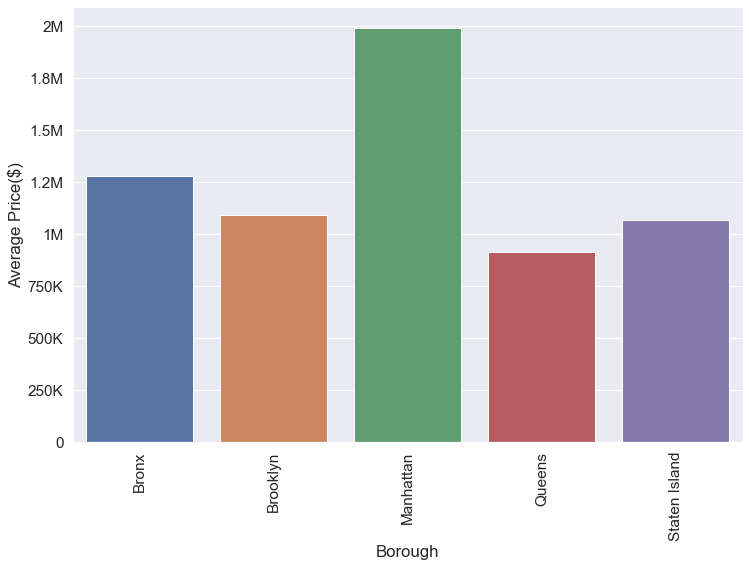

In [342]:
#Lets bar plot the average price of houses by thier boroughs 
plt.subplots(figsize=(12, 8))
sns.barplot(x='Borough', y='price', data=house_prices_borough)
plt.xticks(rotation='vertical')
plt.ylabel('Average Price($)')
plt.xlabel('Borough')
plt.ticklabel_format(style='plain', axis='y')
ax = plt.gca()
ax.yaxis.set_major_formatter(tick.FuncFormatter(reformat_large_tick_values));

Lets look at prices distribution for neighborhoods in Manhatthan

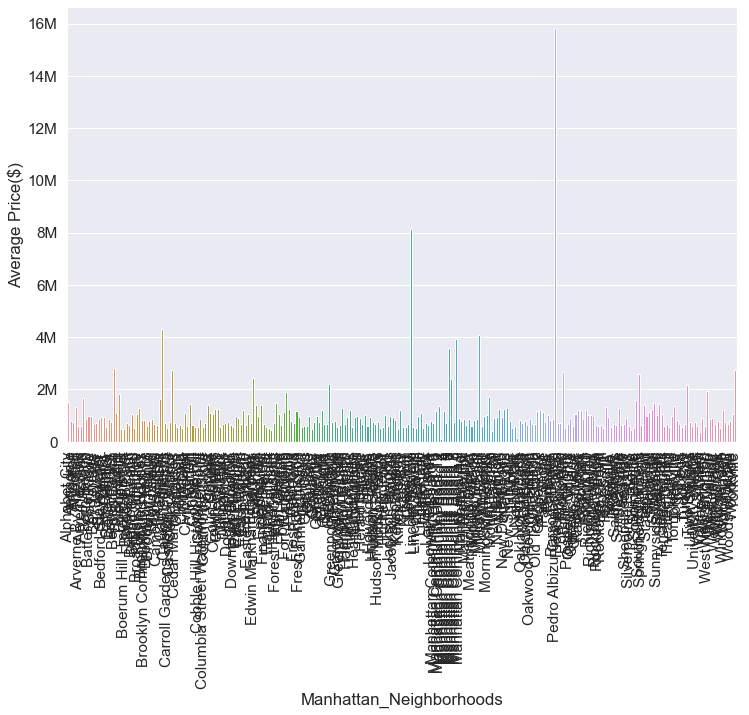

In [352]:
Manhattan_neighborhood = final_nyc[final_nyc['Borough'] == 'Manhattan']
manhattan_house_prices_neighborhood = Manhattan_neighborhood[['Neighborhood','price']].groupby('Neighborhood', as_index=False).mean().round()
plt.subplots(figsize=(12, 8))
sns.barplot(x='Neighborhood', y='price', data=house_prices_neighborhood)
plt.xticks(rotation='vertical')
plt.ylabel('Average Price($)')
plt.xlabel('Manhattan_Neighborhoods')
plt.ticklabel_format(style='plain', axis='y')
ax = plt.gca()
ax.yaxis.set_major_formatter(tick.FuncFormatter(reformat_large_tick_values));

In [349]:
final_nyc[final_nyc['Borough'] == 'Manhattan']

,City,Borough,Neighborhood,address/streetAddress,ZipCode,latitude,longitude,price,propertyTaxRate,Annual_Tax,...,Total_Bathrooms,Full_Bathrooms,Half_Bathrooms,ParkingType,Basement,Cooling_Available,Fireplace_Available,Heating_Available,Spa_Available,Story_Building
0,New York,Manhattan,Marble Hill,60 Terrace View Ave,10463.0,40.877743,-73.910866,799999.0,0.88,5096.0,...,2.0,1.0,1.0,Driveway,True,True,False,True,False,1.0
5,New York,Manhattan,Inwood,24 Cooper St #5CD,10034.0,40.867687,-73.924606,230000.0,0.88,NaN,...,2.0,2.0,0.0,0 spaces,False,False,False,False,False,1.0
9,Bronx,Manhattan,Marble Hill,3135 Johnson Ave APT 5E,10463.0,40.882801,-73.911102,450000.0,0.95,NaN,...,2.0,2.0,0.0,"Garage, Storage, On Street, Waitlist",False,True,False,True,False,1.0
17,New York,Manhattan,Inwood,70 Park Ter W PENTHOUSE 83E,10034.0,40.871246,-73.916939,849999.0,0.88,NaN,...,2.0,2.0,0.0,0 spaces,False,False,False,False,False,1.0
24,New York,Manhattan,Inwood,585 W 214th St #5A,10034.0,40.871948,-73.919456,269000.0,0.88,NaN,...,1.0,1.0,0.0,0 spaces,False,False,False,False,False,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58105,New York,Manhattan,Pedro Albizu Campos Plaza,223-229 Avenue C,10009.0,40.728298,-73.976128,31289811.0,0.88,124123.0,...,5.0,NaN,NaN,0 spaces,False,False,False,False,False,14.0
58107,New York,Manhattan,Alphabet City,434 E 10th St,10009.0,40.725060,-73.976189,1550000.0,0.88,12166.0,...,3.0,NaN,NaN,0 spaces,False,False,False,False,False,4.0
58109,New York,Manhattan,Alphabet City,263 E 7th St,10009.0,40.723694,-73.977364,6300000.0,0.88,11929.0,...,5.0,4.0,1.0,0 spaces,False,True,False,False,False,3.0
58110,New York,Manhattan,Alphabet City,620 E 13th St,10009.0,40.728142,-73.977707,5500000.0,0.88,NaN,...,4.0,NaN,NaN,0 spaces,False,False,False,False,False,10.0


In [356]:
# house_prices_neighborhood = final_nyc[['Neighborhood','price']].groupby('Neighborhood', as_index=False).mean().round()
# plt.subplots(figsize=(12, 8))
# sns.barplot(x='Neighborhood', y='price', data=house_prices_neighborhood)
# plt.xticks(rotation='vertical')
# plt.ylabel('Average Price($)')
# plt.xlabel('Neighborhoods')
# plt.ticklabel_format(style='plain', axis='y')
# ax = plt.gca()
# ax.yaxis.set_major_formatter(tick.FuncFormatter(reformat_large_tick_values));

## 1.7 Neighborhood Summary Statistics <a id='1.7_Neighborhood_Summary_Statistics'></a>

In [353]:
neighborhood_summary = final_nyc.groupby('Neighborhood').agg(
    houses_in_neighborhood = pd.NamedAgg(column='Neighborhood', aggfunc='count'),
    average_price = pd.NamedAgg(column='price', aggfunc='mean'),
    average_bedrooms = pd.NamedAgg(column='Bedrooms', aggfunc='mean'),
    average_bathrooms = pd.NamedAgg(column='Total_Bathrooms', aggfunc='mean'),
    average_stories_of_buidling = pd.NamedAgg(column='Story_Building', aggfunc='mean')
)

In [354]:
neighborhood_summary['average_price'] = round(neighborhood_summary['average_price'])
neighborhood_summary['average_bedrooms'] = round(neighborhood_summary['average_bedrooms'])
neighborhood_summary['average_bathrooms'] = round(neighborhood_summary['average_bathrooms'])
neighborhood_summary['average_stories_of_buidling'] = round(neighborhood_summary['average_stories_of_buidling'])

neighborhood_summary

,houses_in_neighborhood,average_price,average_bedrooms,average_bathrooms,average_stories_of_buidling
Neighborhood,,,,,
Alphabet City,14,1539767.0,3.0,2.0,2.0
Annadale,66,780385.0,4.0,3.0,2.0
Arlington,225,769141.0,4.0,3.0,2.0
Arrochar,226,1315791.0,4.0,3.0,3.0
Arverne By The Sea,94,620102.0,4.0,3.0,2.0
...,...,...,...,...,...
Woodhaven,42,738843.0,4.0,3.0,2.0
Woodrow,283,692336.0,4.0,3.0,2.0
Woods of Arden,46,797756.0,4.0,3.0,2.0


## 1.8 Save Data <a id='1.8_Save_Data'></a>

In [ ]:
#Lets see what our new dataframe looks like
final_nyc.info()
final_nyc.shape

In [ ]:
final_nyc.to_csv(r'C:\Users\izine\Desktop\GitHub\Springboard-Data-Science\Capstone 1\Data\final_nyc_cleaned.csv', index=False)

## 1.9 Summary <a id='1.9_Summary'></a>

In [ ]:
from pandas_profiling import ProfileReport

In [358]:
profile = ProfileReport(final_nyc, title='Pandas Profiling Report', explorative=True)
profile

We are tasked to best estimates prices for houses being built by Capital Fortune real-estate company, who are building houses in Brooklyn, NY. We extracted data from the nyc_housing data from zillow. We need to build a predict model which can best estimate prices for the houses given the brooklyn market. 

We started by inspecting our original dataframe which had over 75k rows and 1507 columns, we began to start cleaning our data as a lot of our columns which were not relevant or repeated information of other columns. We needed to isolate the dataframe for our target location which is Brooklyn so we filtered our nyc dataframe to all address which resided in Brooklyn. 

Next step was to clean up some of the data types for our columns, unfortunately there were a lot of missing data to counter-act we either dropped those columns or imputed data to some important columns. For instance we change our column type of Has_Basement to True or False to simplify this feature. our column names were quite un-intuitive from the original datafile so we relabeled a lot of them for more readable names.  

We noticed there were a lot fo houses which were sold for prices far below their market value for instance a million dollar house was sold for 5000, these are cases where family members sell their property to other family and friends to change ownership and etc. So we excluded these houses, the opposite was also the case there were few observations where their price was 100 million and above we realized a lot of the hometype labeled vacant land were lots for large office space and warehouses behind sold, as these properties does not relate to houses being built by Capital Fortune we ommited these as well. 

We wanted to do an analysis on neighborhoods in brooklyn and how their prices differ so we utilized a geolocator to reverse geocode neighborhoods using latitudes and longitudes which was in our dataframe. One issue was a lot of neighborhood in the Kings County distinct was not coming up in our API so we left them as Kings County thus why they have the largest number of rows. 

Reverse geolocation was a interesting idea but the time it takes to process is unbearable, as we are capped to one requests per second with our API, it took hours to finish our neighborhood look up. But once we gathered all the neighborhoods via its latitude and longitude we were able to see how the average price of their houses were distributed for each neighborhood. We also peeked into some neighborhood summary

While this was a cleaning of the data I believe we better fine tune our data and perphaps impute more missing data based on better classification rather than just using the average. 